In [1]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
matplotlib.use('Agg')
import datetime
import seaborn as sns
import pickle
%matplotlib inline
from finrl.config_tickers import DOW_30_TICKER
from finrl.meta.preprocessor.yahoodownloader import YahooDownloader
from finrl.meta.preprocessor.preprocessors import data_split
from stock_env import StockTradingEnv
from finrl.agents.stablebaselines3.models import DRLAgent,DRLEnsembleAgent
from finrl.plot import backtest_stats, backtest_plot, get_daily_return, get_baseline,trx_plot
from feature_engineer import FeatureEngineer
from models import DRLAgent
from portfolio_optimization_env import PortfolioOptimizationEnv
from pprint import pprint
import scienceplots
import sys
sys.path.append("../FinRL-Library")
import quantstats as qs
plt.style.use('science')
import os
from finrl.main import check_and_make_directories
from finrl.config import (
    DATA_SAVE_DIR,
    TRAINED_MODEL_DIR,
    TENSORBOARD_LOG_DIR,
    RESULTS_DIR,
    INDICATORS,
    TRAIN_START_DATE,
    TRAIN_END_DATE,
    TEST_START_DATE,
    TEST_END_DATE,
    TRADE_START_DATE,
    TRADE_END_DATE,
)

check_and_make_directories([DATA_SAVE_DIR, TRAINED_MODEL_DIR, TENSORBOARD_LOG_DIR, RESULTS_DIR])

def DRL_prediction(model, environment,time_window, deterministic=True):
    """make a prediction and get results"""
    test_env, test_obs = environment.get_sb_env()
    account_memory = None  # This help avoid unnecessary list creation
    actions_memory = None  # optimize memory consumption
    # state_memory=[] #add memory pool to store states

    test_env.reset()
    max_steps = len(environment._df.index.unique()) - time_window - 1

    for i in range(len(environment._df.index.unique())):
        action, _states = model.predict(test_obs, deterministic=deterministic)
        # account_memory = test_env.env_method(method_name="save_asset_memory")
        # actions_memory = test_env.env_method(method_name="save_action_memory")
        test_obs, rewards, dones, info = test_env.step(action)
        if i == max_steps:  # more descriptive condition for early termination to clarify the logic
            date_list = environment._date_memory
            portfolio_return = environment._portfolio_return_memory
            # print(len(date_list))
            # print(len(asset_list))
            df_account_value = pd.DataFrame(
                {"date": date_list, "daily_return": portfolio_return,'account' :  environment._asset_memory["final"],'weights':environment._final_weights}
            )
            df_date = pd.DataFrame(date_list)
            df_date.columns = ["date"]

            action_list = environment._actions_memory
            df_actions = pd.DataFrame(action_list)
            tiks = environment._tic_list
            df_actions.columns = np.insert(tiks,0,'POS')
            df_actions.index = df_date.date
            # df_actions = pd.DataFrame({'date':date_list,'actions':action_list})
            account_memory = df_account_value
            actions_memory = df_actions
        # add current state to state memory
        # state_memory=test_env.env_method(method_name="save_state_memory")

        if dones[0]:
            print("hit end!")
            break
    return account_memory, actions_memory,test_obs
TRAIN_START_DATE = '2000-01-01'
TRAIN_END_DATE = '2022-12-30'
TEST_START_DATE = '2023-01-01'
TEST_END_DATE = '2024-10-01'
from pandas import read_csv


df_dow =read_csv('./data/dow.csv')
df_nasdaq =read_csv('./data/nasdaq.csv')
df_hsi = read_csv('./data/hsi.csv')
df_dax = read_csv('./data/dax.csv')
df_sp500 = read_csv('./data/sp500.csv')

In [ ]:
from finrl.config_tickers import DOW_30_TICKER,NAS_100_TICKER,HSI_50_TICKER,DAX_30_TICKER,SP_500_TICKER


In [ ]:
import yahoo_fin.stock_info as si
ticks = si.tickers_ftse100(True)
sp500 = si.tickers_sp500(True)
dow = si.tickers_dow(True)
nifty = si.tickers_nifty50(True)
display(ticks.head(100))


Warning - Certain functionality 
             requires requests_html, which is not installed.
             
             Install using: 
             pip install requests_html
             
             After installation, you may have to restart your Python session.


,Company,Ticker,FTSE industry classification benchmark sector[25]
0,3i,III,Financial services
1,Admiral Group,ADM,Insurance
2,Airtel Africa,AAF,Telecommunications services
3,Anglo American plc,AAL,Mining
4,Antofagasta plc,ANTO,Mining
...,...,...,...
95,Vistry Group,VTY,Home Construction
96,Vodafone Group,VOD,Mobile telecommunications
97,Weir Group,WEIR,Industrial goods and services
98,Whitbread,WTB,Retail hospitality


In [ ]:

df_dow = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = DOW_30_TICKER).fetch_data()
df_nasdaq = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = NAS_100_TICKER).fetch_data()
df_hsi = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = HSI_50_TICKER).fetch_data()
df_dax = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = DAX_30_TICKER).fetch_data()

In [7]:

df_sp500 = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = SP_500_TICKER).fetch_data()


[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['PXD']: YFTzMissingError('$%ticker%: possibly delisted; No timezone found')
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*****

Shape of DataFrame:  (2545839, 8)


In [4]:
df_dow.to_csv('./data/dow.csv')
df_nasdaq.to_csv('./data/nasdaq.csv')
df_hsi.to_csv('./data/hsi.csv')
df_dax.to_csv('./data/dax.csv')
df_sp500.to_csv('./data/sp500.csv')



NameError: name 'df_dow' is not defined

In [8]:
df_sp500.to_csv('./data/sp500.csv')


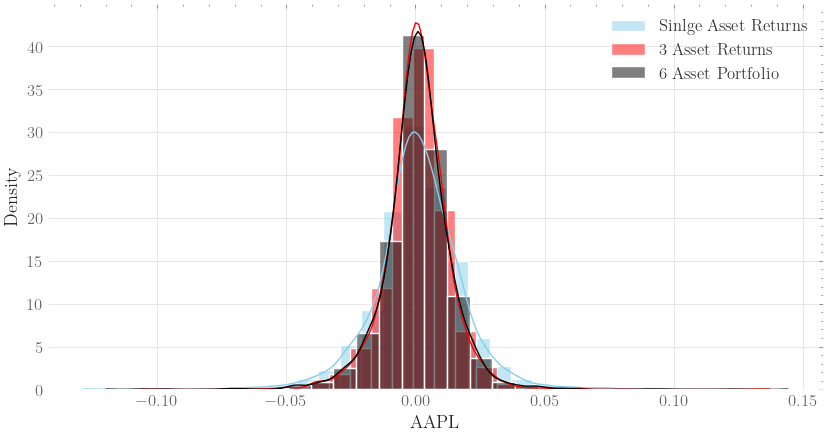

In [239]:
df = df_dow
pv = df.pivot(index='date',columns='tic',values='close')
pv  = pv.pct_change()
%matplotlib inline
plt.figure(figsize=(10,5))
sns.histplot(pv['AAPL'], kde=True, stat="density", bins=30, color="skyblue", label="Sinlge Asset Returns")
sns.histplot(pv.iloc[:,0:3].dot([0.3,0.4,0.3]), kde=True, stat="density", bins=30, color="red", label="3 Asset Returns")
sns.histplot(pv.iloc[:,0:6].dot([0.1,0.2,0.3,0.1,0.2,0.1]), kde=True, stat="density", bins=30, color="black", label="6 Asset Portfolio")
plt.legend()


# Env Creation for training and test

In [240]:
df_dow.tic.unique()

array(['AAPL', 'AMGN', 'AXP', 'BA', 'CAT', 'CRM', 'CSCO', 'CVX', 'DIS',
       'GS', 'HD', 'HON', 'IBM', 'INTC', 'JNJ', 'JPM', 'KO', 'MCD', 'MMM',
       'MRK', 'MSFT', 'NKE', 'PG', 'TRV', 'UNH', 'V', 'VZ', 'WBA', 'WMT',
       'DOW'], dtype=object)

In [3]:
INDICATORS = [
    "close_5_ema",
    "close_21_ema",
    "close_62_ema",
]
fe = FeatureEngineer(use_technical_indicator=True,
                     tech_indicator_list = INDICATORS,
                     use_turbulence=True,
                     user_defined_feature = True)

processed_dax = fe.preprocess_data(df_dow)
processed_dax = processed_dax.copy()
processed_dax = processed_dax.fillna(0)
processed_dax = processed_dax.replace(np.inf,0)
train_data = data_split(processed_dax, TRAIN_START_DATE, TRAIN_END_DATE)
test_data = data_split(processed_dax, TEST_START_DATE, TEST_END_DATE)
stock_dimension = len(train_data.tic.unique())
state_space = 1 + 2*stock_dimension + len(INDICATORS)*stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

Successfully added technical indicators
Successfully added turbulence index
Successfully added user defined features
Stock Dimension: 29, State Space: 146


In [4]:
df =df_dow.copy()
df.set_index('date',inplace=True)
prices = df.pivot(columns='tic')['close'].dropna(how='all')

In [33]:
prices.drop(columns=['DOW'],axis=0,inplace=True)

In [34]:
from pypfopt import risk_models
sampe_covariance_matrix = risk_models.sample_cov(prices,frequency=252)

In [ ]:
sampe_covariance_matrix

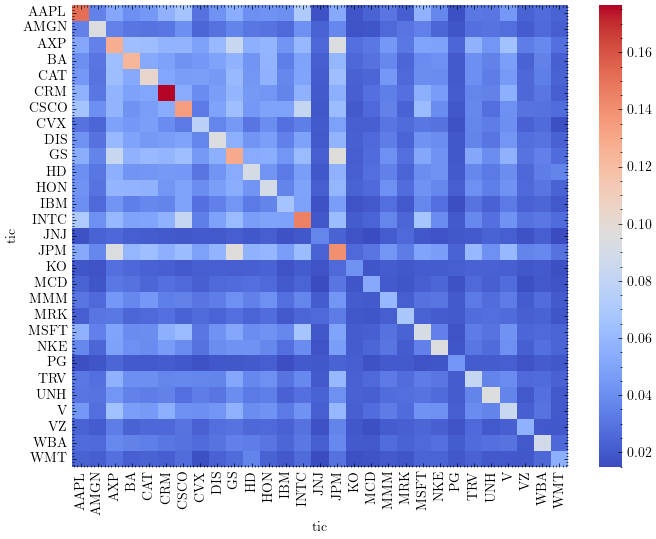

In [42]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
fig, ax = plt.subplots(figsize=(8,6))
sns.heatmap(sampe_covariance_matrix,ax=ax,cmap="coolwarm")
plt.show()

# Modern Portfoli Theory
Portfolio optimization 

In [108]:
import numpy as np
import pandas as pd

# Example historical data: returns for two assets over a 5-year period (say monthly returns)
historical_returns = pd.DataFrame({
    'Asset_1': np.random.randn(60),  # 5 years of monthly returns for Asset 1
    'Asset_2': np.random.randn(60)   # 5 years of monthly returns for Asset 2
})

# Historical covariance matrix
S_historical = historical_returns.cov()

# Example future data: returns for the next 2 years (24 months)
future_returns = pd.DataFrame({
    'Asset_1': np.random.randn(24),  # 2 years of monthly returns for Asset 1
    'Asset_2': np.random.randn(24)   # 2 years of monthly returns for Asset 2
})

# Future covariance matrix
S_future = future_returns.cov()

# Compute Frobenius norm as a measure of difference
frobenius_norm = np.linalg.norm(S_historical - S_future, 'fro')
print("Frobenius Norm Difference:", frobenius_norm)


Frobenius Norm Difference: 0.147680304480158


# Dow Jones Industrial Average
The Dow Jones Industrial Average, Dow Jones, or simply the Dow, is a stock market index of 30 prominent companies listed on stock exchanges in the United States. The DJIA is one of the oldest and most commonly followed equity indexes. 


Constituents: 30

Exchanges: New York Stock Exchange; Nasdaq

Foundation: February 16, 1885; 139 years ago (as DJA); May 26, 1896 (as DJIA)

Market cap: US$12.0 trillion; (as of December 29, 2023)

Trading symbol: ^DJI; $INDU.DJI; DJIA

Weighting method: Price-weighted index

## PPO


In [3]:
INDICATORS = [
    "close_5_ema",
]
fe = FeatureEngineer(use_technical_indicator=False,
                     tech_indicator_list = INDICATORS,
                     use_turbulence=False,
                     user_defined_feature = True)

processed_dax = fe.preprocess_data(df_dow)
processed_dax = processed_dax.copy()
processed_dax = processed_dax.fillna(0)
processed_dax = processed_dax.replace(np.inf,0)
train_data = data_split(processed_dax, TRAIN_START_DATE, TRAIN_END_DATE)
test_data = data_split(processed_dax, TEST_START_DATE, TEST_END_DATE)
stock_dimension = len(train_data.tic.unique())
state_space = 1 + 2*stock_dimension + len(INDICATORS)*stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")
train_data = train_data.rename(columns={'daily_return':'change'})
test_data  = test_data.rename(columns={'daily_return':'change'})

Successfully added user defined features
Stock Dimension: 29, State Space: 88


In [3]:
ppo_result ={}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return"],
    'comission_fee_pct':0.001,
    'time_window':5
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)
est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.01,
    "learning_rate": 0.0003,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo"
                            ,model_kwargs = PPO_PARAMS)
ppo_model = agent.train_model(model=model_ppo, 
                            tb_log_name='ppo',
                            total_timesteps=50_000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "weights": e_train_gym._final_weights,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
ppo_predictions = DRL_prediction(ppo_model, est,5)
ppo_result["train"] =  metrics_df_dax
ppo_result["test"] =ppo_predictions

{'n_steps': 2048, 'ent_coef': 0.01, 'learning_rate': 0.0003, 'batch_size': 128}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-------------------------------------
| time/              |              |
|    fps             | 50           |
|    iterations      | 1            |
|    time_elapsed    | 40           |
|    total_timesteps | 2048         |
| train/             |              |
|    reward          | -0.012853864 |
-------------------------------------
Initial portfolio value:1000000
Final portfolio value: 1417254.25
Final accumulative portfolio value: 1.41725425
Maximum DrawDown: -0.31572651758421777
Sharpe ratio: 0.2451327270325874
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 3.27e+03     |
|    ep_rew_mean          | 0.359        |
| time/                   |              |
|    fps                  | 48           |
|    iterations           | 2           

max drowdown: -0.08558776576991056 Sharp ratio: 1.2203547302002942


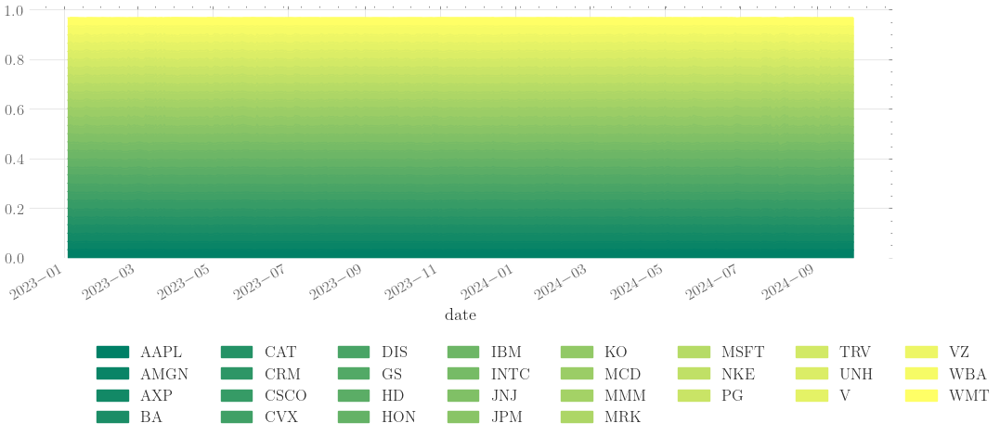

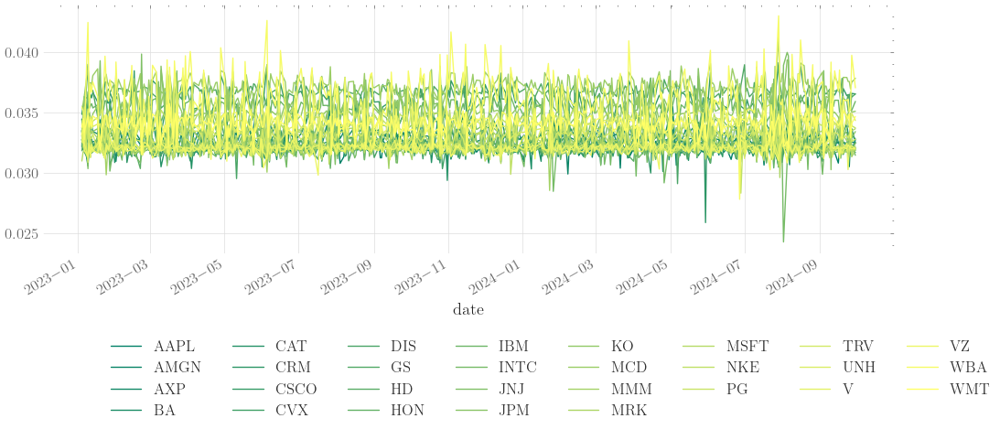

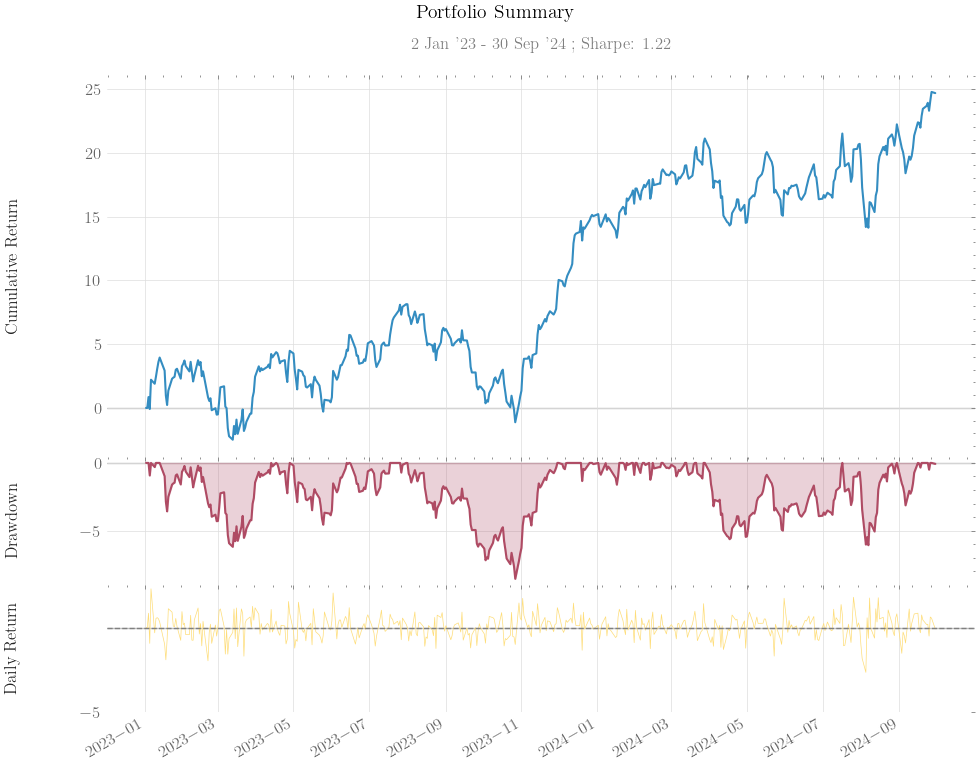

In [ ]:
w = pd.DataFrame(results_ppo['test_df'][0].weights.tolist())
w = w.drop(columns=[0],axis=0)
columns = test_data.tic.unique().tolist()
columns.append('date')
w['date'] = results_ppo['test_df'][0].date
w.columns = columns
w.iloc[1:,].plot(x='date',figsize=(12,4),kind='area', stacked=True,colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
w.iloc[1:,].plot(x='date',figsize=(12,4),colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))

zz = results_ppo['test_df'][0]['daily_return']
zz.index=results_ppo['test_df'][0]['date']
print('max drowdown:', qs.stats.max_drawdown(results_ppo['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results_ppo['test_df'][0].daily_return))
qs.plots.snapshot(zz)


In [ ]:
with open('./models/ppo.pkl','wb') as f:
    pickle.dump(results_ppo,f)

In [37]:
with open('./models/ppo.pkl','rb') as f:
    results = pickle.load(f)

## Actor Advantage Critic

## Training The Model

In [4]:
from finrl.agents.stablebaselines3.models import DRLAgent

a2c_results= {}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return"],
    'comission_fee_pct':0.001,
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)

est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
model_a2c = agent.get_model("a2c")
a2c_model = agent.train_model(model=model_a2c, 
                            tb_log_name='a2c',
                            total_timesteps=50000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "weights": e_train_gym._final_weights,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
a2c_predictions = DRL_prediction(a2c_model, est,1)
a2c_results["train_df"] =  metrics_df_dax
a2c_results["test_df"] = a2c_predictions


{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0007}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-----------------------------------------
| time/                 |               |
|    fps                | 44            |
|    iterations         | 100           |
|    time_elapsed       | 11            |
|    total_timesteps    | 500           |
| train/                |               |
|    entropy_loss       | -45           |
|    explained_variance | -0.908        |
|    learning_rate      | 0.0007        |
|    n_updates          | 99            |
|    policy_loss        | -0.58         |
|    reward             | -0.0013297693 |
|    std                | 1.08          |
|    value_loss         | 0.000241      |
-----------------------------------------
----------------------------------------
| time/                 |              |
|    fps                | 46           |
|    iterations         | 200          |
|    time_e

max drowdown: -0.08346538839290496 Sharp ratio: 1.2677592339388668


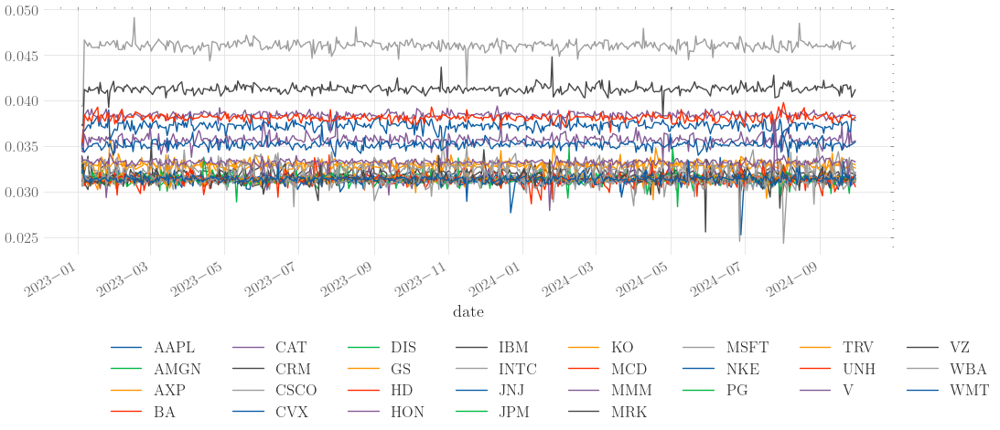

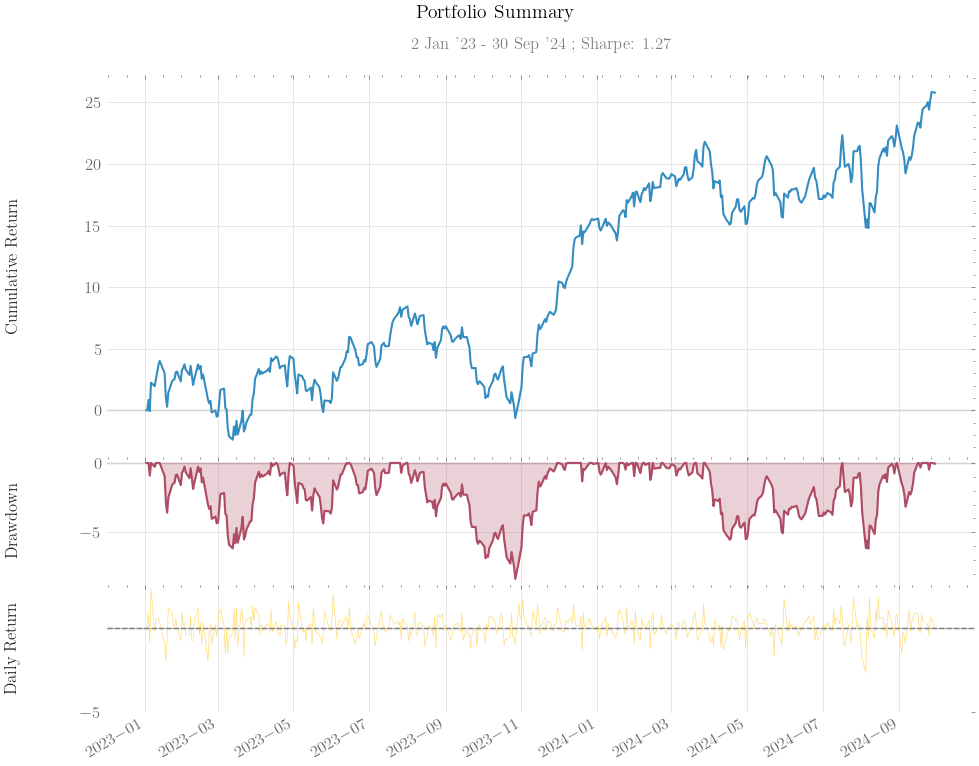

<Axes: xlabel='date'>

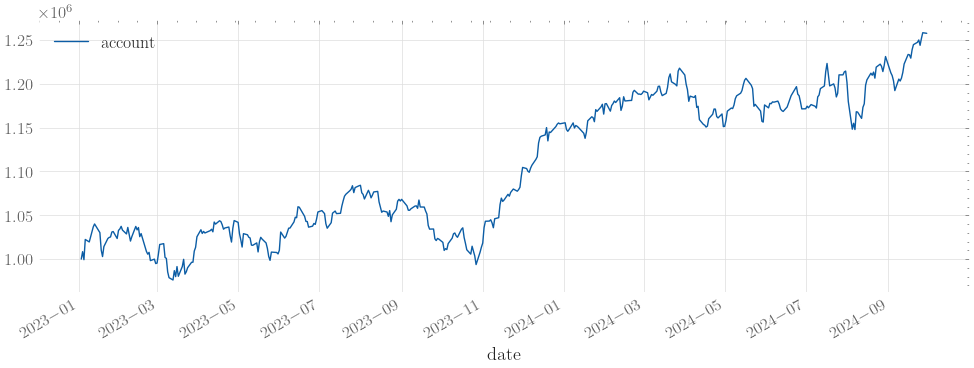

In [6]:
w = pd.DataFrame(results['test_df'][0].weights.tolist())
w = w.drop(columns=[0],axis=0)
columns = test_data.tic.unique().tolist()
columns.append('date')
w['date'] = results['test_df'][0].date
w.columns = columns
w.iloc[1:,].plot(x='date',figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
zz = results['test_df'][0]['daily_return']
zz.index=results['test_df'][0]['date']
print('max drowdown:', qs.stats.max_drawdown(results['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results['test_df'][0].daily_return))
qs.plots.snapshot(zz)
results['test_df'][0].plot(x='date',y='account',figsize=(12,4))

In [52]:
with open('./models/a2c.pkl','wb') as f:
    pickle.dump(results,f)

## Buy and hold strategy

In [63]:
test_data

,Unnamed: 0,date,open,high,low,close,volume,tic,day,return
0,95843,2023-01-03,130.279999,130.899994,124.169998,123.904625,112117500,AAPL,1,-0.037405
0,95844,2023-01-03,260.869995,262.600006,258.869995,247.431015,2594800,AMGN,1,-0.003769
0,95845,2023-01-03,149.539993,150.449997,145.729996,143.260437,2762200,AXP,1,-0.004264
0,95846,2023-01-03,192.949997,197.179993,192.399994,195.389999,8624600,BA,1,0.025723
0,95847,2023-01-03,240.679993,240.679993,236.199997,231.220352,2651900,CAT,1,-0.002839
...,...,...,...,...,...,...,...,...,...,...
437,108978,2024-09-30,583.500000,586.419983,578.739990,584.679993,3009700,UNH,0,0.004864
437,108979,2024-09-30,275.000000,275.690002,273.200012,274.950012,5969900,V,0,-0.000800
437,108980,2024-09-30,45.130001,45.360001,44.790001,44.219704,13509700,VZ,0,0.000446
437,108981,2024-09-30,9.130000,9.290000,8.940000,8.960000,20239900,WBA,0,-0.011038


In [23]:
stock_dimension = len(train_data.tic.unique())


In [4]:
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return"],
    'time_window':5,
    "comission_fee_pct": 0.001,
}
environment_train_buy_and_hold = PortfolioOptimizationEnv(
    df = test_data,
    **env_kwargs
)
terminated = False

environment_train_buy_and_hold.reset()

while not terminated:
    action = [0] + [1/stock_dimension] * stock_dimension
    _, _, terminated, _ = environment_train_buy_and_hold.step(
        np.array(action, dtype=np.float32))

Initial portfolio value:1000000
Final portfolio value: 1241232.75
Final accumulative portfolio value: 1.24123275
Maximum DrawDown: -0.08721632703799198
Sharpe ratio: 1.1840124549168198


-0.08721621514346523


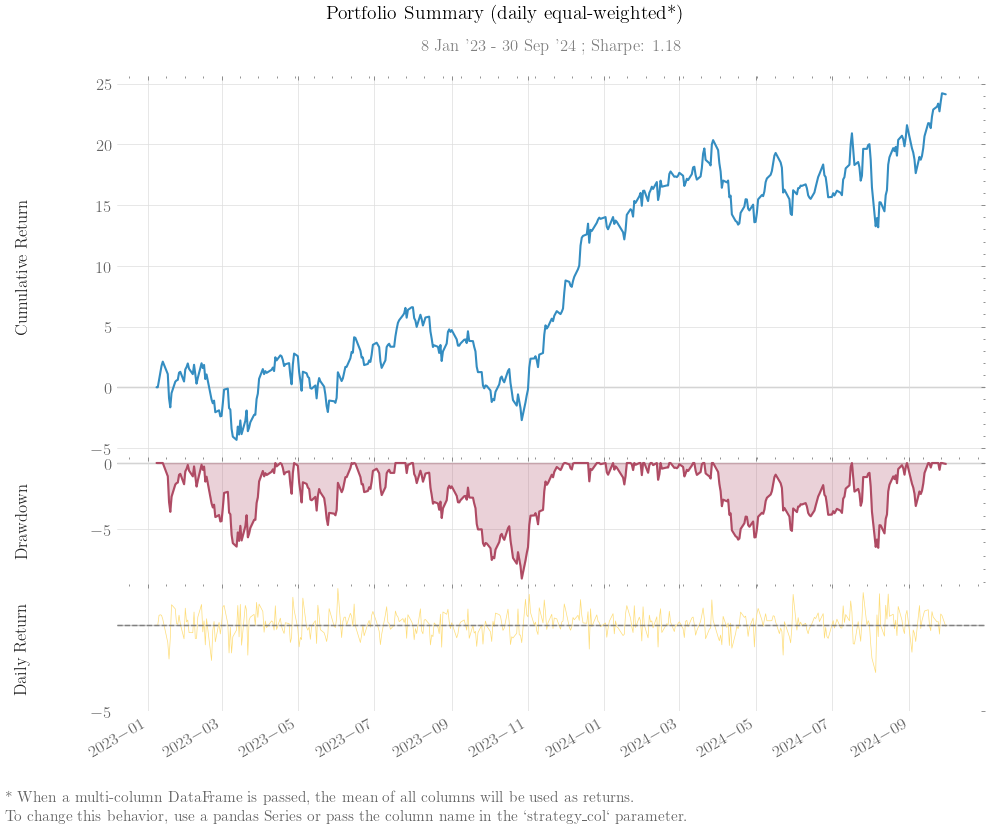

<Axes: >

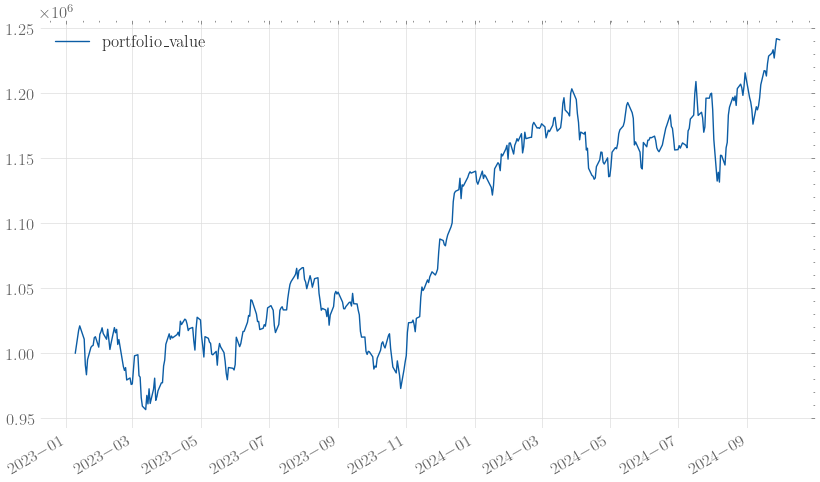

In [5]:
buy_and_hold_train = environment_train_buy_and_hold._asset_memory["final"]
buy_and_hold_weights_train = environment_train_buy_and_hold._final_weights
buy_and_hold_weights_df = pd.DataFrame(buy_and_hold_weights_train)

bh = pd.DataFrame(buy_and_hold_train,environment_train_buy_and_hold._date_memory)

buy_and_hold_weights_df.drop(buy_and_hold_weights_df.columns[0],axis=1,inplace=True)
buy_and_hold_weights_df.columns = test_data.tic.unique()
bh['returns'] = environment_train_buy_and_hold._portfolio_return_memory
bh.columns = ['portfolio_value','returns']
bh.head()
print(qs.stats.max_drawdown(bh['returns']))
qs.plots.snapshot(bh)
%matplotlib inline
bh.plot(figsize=(10,6),y ='portfolio_value')

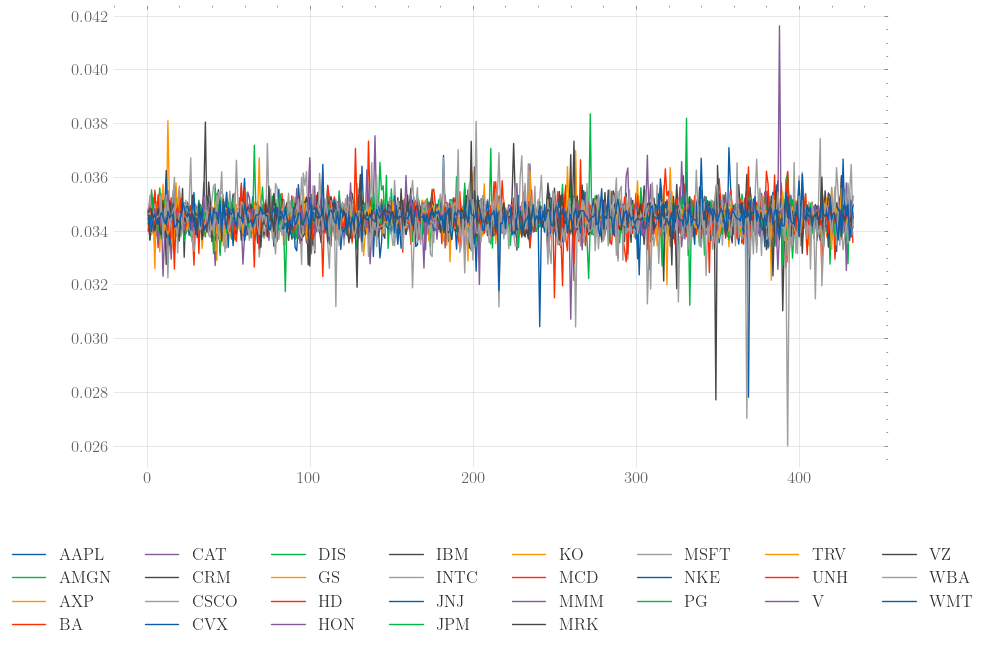

In [29]:
buy_and_hold_weights_df.head()
buy_and_hold_weights_df.iloc[1:,:].plot(figsize=(10,6)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))

In [18]:
columns = ['acc_value']
columns.extend(train_data.tic.unique())
columns.extend(train_data.tic.unique() + ['_holding'])
columns.extend(train_data.tic.unique()+['_ma'])

In [19]:
states_ppo = e_train_gym.state_memory
states_ppo_dates = e_train_gym.date_memory
states = np.array(states_ppo)
z2 = pd.DataFrame(states,columns= columns)
holdings = np.array(z2.iloc[:,1:stock_dimension+1]) * np.array(z2.iloc[:,stock_dimension+2 :2*(stock_dimension+1)])
hoding_df = pd.DataFrame(holdings,columns=z2.columns[1:stock_dimension+1].tolist())
total_portfolio_value = holdings.sum(axis=1).reshape(-1, 1)

ppo_weights = holdings /total_portfolio_value
weights_df = pd.DataFrame(ppo_weights, columns=z2.columns[1:stock_dimension + 1].tolist())



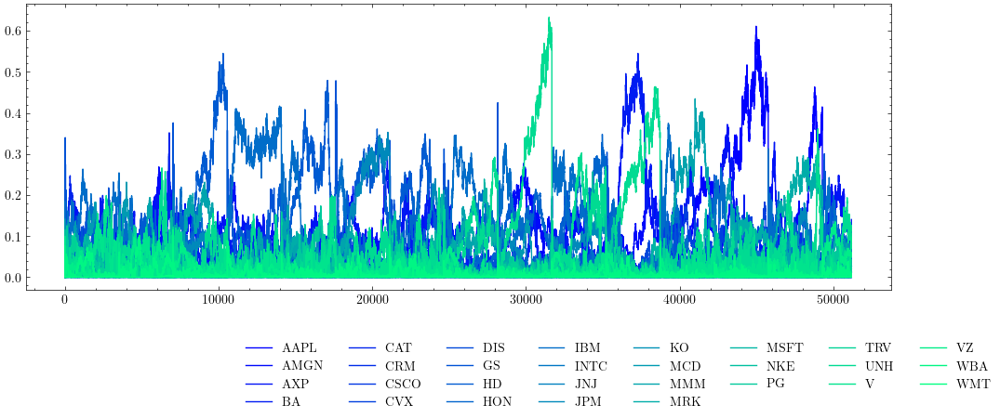

In [32]:
weights_df.plot(colormap="winter",figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))

## Mean Variance Optimization

In [70]:
from pypfopt import expected_returns

df = df_dow.copy()
df = df.sort_values(['date', 'tic'], ignore_index=True)
df.index = df.date.factorize()[0]
cov_list = []
mu= []
# look back is one year
lookback = 252
for i in range(lookback, len(df.index.unique())):
    data_lookback = df.loc[i-lookback:i, :]
    price_lookback = data_lookback.pivot_table(
        index='date', columns='tic', values='close')
    return_lookback = price_lookback.pct_change().dropna()
    covs = return_lookback.cov().values
    mu.append(expected_returns.mean_historical_return(price_lookback))
    cov_list.append(covs)
df_cov = pd.DataFrame(
{'time': df.date.unique()[lookback:], 'cov_list': cov_list,'returns':mu})
df = df.merge(df_cov, left_on='date',right_on='time')

In [77]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent

test_df = data_split(
df,
start=TEST_START_DATE,
end=TEST_END_DATE
)

stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.001,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym)
markowitz_history_df = agent.prediction(e_test_gym)
markowitz_history_df["method"] = "markowitz"


Stock Dimension: 30, State Space: 30
begin_total_asset:1000000
end_total_asset:1148877.2265059808
Sharpe:  0.8111291596655518
Test Finished!
episode_return 1.1488772265059808


In [78]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent

test_df = data_split(
df,
start=TEST_START_DATE,
end=TEST_END_DATE
)

stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.001,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym,objective='sharpe')
max_sharpe = agent.prediction(e_test_gym)
max_sharpe["method"] = "markowitz"


Stock Dimension: 30, State Space: 30
begin_total_asset:1000000
end_total_asset:1187748.909480629
Sharpe:  0.7788109639811434
Test Finished!
episode_return 1.187748909480629


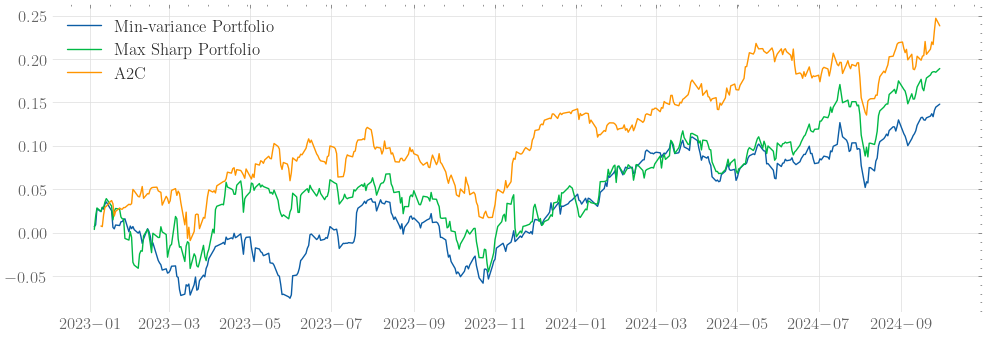

In [47]:
%matplotlib inline

plt.figure(figsize=(12,4))
plt.plot(markowitz_history_df.date,markowitz_history_df.total_assets.pct_change().cumsum(),label='Min-variance Portfolio')
plt.plot(max_sharpe.date,max_sharpe.total_assets.pct_change().cumsum(),label='Max Sharp Portfolio')
plt.plot(results['test_df'][0].get('date'),results['test_df'][0]['account'].pct_change().cumsum(),label='A2C')

plt.legend()
plt.show()


## Methods Comparison

In [31]:
stock_index = YahooDownloader(start_date = TEST_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = ["^dji"]).fetch_data()

[*********************100%%**********************]  1 of 1 completed

Shape of DataFrame:  (438, 8)


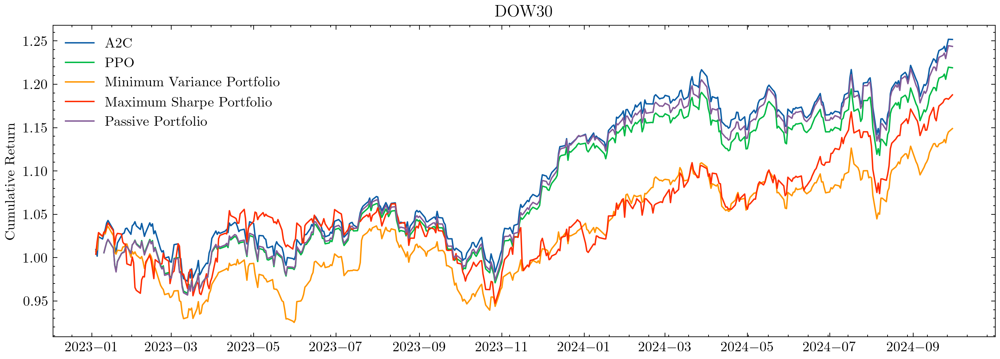

In [10]:
%matplotlib inline

with plt.style.context('science','ieee'):
    plt.figure(figsize=(12,4),dpi=300)
    plt.plot(result_dow['A2C']['test_df'][0].get('date'),(result_dow['A2C']['test_df'][0]['account'].pct_change() +1).cumprod(),label='A2C')
    plt.plot(result_dow['PPO']['test'][0].get('date'),(result_dow['PPO']['test'][0]['account'].pct_change() +1).cumprod(),label='PPO')
    plt.plot(result_dow['MinVar'].date,(result_dow['MinVar'].total_assets.pct_change() + 1).cumprod(),label='Minimum Variance Portfolio')
    plt.plot(result_dow['maxsharp'].date,(result_dow['maxsharp'].total_assets.pct_change() +1).cumprod(),label='Maximum Sharpe Portfolio') 
    plt.plot(result_dow['BH']._date_memory,(pd.Series(result_dow['BH']._asset_memory["final"]).pct_change() + 1).cumprod(),label = 'Passive Portfolio')
    plt.legend()
    plt.ylabel('Cumulative Return')
    plt.title('DOW30')
    plt.show()

In [87]:
metric_dow = pd.DataFrame({
    "method" : ['Min-variane', 'Max Sharpe','A2C','PPO','Buy and Hold'],
    "returns": [result_dow['MinVar'].total_assets[len(result_dow['MinVar'].total_assets)-1] / result_dow['MinVar'].total_assets[0],
                result_dow['maxsharp'].total_assets[len(result_dow['maxsharp'].total_assets)-1] / result_dow['maxsharp'].total_assets[0],
                result_dow['A2C']['test_df'][0]['account'][len(result_dow['A2C']['test_df'][0]['account'])-1] / result_dow['A2C']['test_df'][0]['account'][0],
                result_dow['PPO']['test'][0]['account'][len(result_dow['PPO']['test'][0]['account'])-1] / result_dow['PPO']['test'][0]['account'][0],
                result_dow['BH']._asset_memory["final"][len(result_dow['BH']._asset_memory["final"])-1] / result_dow['BH']._asset_memory["final"][0],
                ],
    "Sharp ratio": [ qs.stats.sharpe(result_dow['MinVar'].total_assets)
                    ,qs.stats.sharpe(result_dow['maxsharp'].total_assets)
                    ,qs.stats.sharpe(result_dow['A2C']['test_df'][0]['account'])
                    ,qs.stats.sharpe(result_dow['PPO']['test'][0]['account'])
                    ,qs.stats.sharpe(pd.Series(result_dow['BH']._asset_memory["final"]))],
    "Maximum Drowdown": [ 
                     (qs.stats.max_drawdown(result_dow['MinVar'].total_assets)*100).round(2)
                    ,(qs.stats.max_drawdown(result_dow['maxsharp'].total_assets) *100).round(2)
                    ,(qs.stats.max_drawdown(result_dow['A2C']['test_df'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(result_dow['PPO']['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(pd.Series(result_dow['BH']._asset_memory["final"]))*100).round(2)
                    ]

})
metric_dow

,method,returns,Sharp ratio,Maximum Drowdown
0,Min-variane,1.148877,0.810204,-10.69
1,Max Sharpe,1.187749,0.777923,-10.80
2,A2C,1.251670,1.248310,-8.13
3,PPO,1.219004,1.122287,-8.59
4,Buy and Hold,1.243625,1.194077,-8.70


In [85]:
result_dow.keys()

dict_keys(['PPO', 'A2C', 'BH', 'MinVar', 'maxsharp'])

In [8]:
result_dow = {}
with open('./data/dow.pkl','rb') as f:
    result_dow= pickle.load(f)

In [ ]:
result_dow = {
    'PPO': ppo_result,
    'A2C': a2c_results,
    'BH': environment_train_buy_and_hold,
    'MinVar': markowitz_history_df,
    'maxsharp': max_sharpe,
}

In [80]:
with open('./data/dow.pkl','wb') as f:
    pickle.dump(result_dow,f)

# DAX
is a stock market index consisting of the 40 major German blue chip companies trading on the Frankfurt Stock Exchange. It is a total return index. Prices are taken from the Xetra trading venue. Wikipedia
Constituents: 40 (expanded from 30 in 2021)
Exchanges: Frankfurt Stock Exchange
Foundation: 1 July 1988
Market cap: €1,245 billion (7 May 2021)
Operator: STOXX (Qontigo, Deutsche Börse)
Related indices: MDAX, SDAX, TecDAX, ÖkoDAX
Weighting method: Capitalization-weighted

In [2]:
INDICATORS = [
    "close_62_ema",
    "close_21_ema",
    "close_5_ema",
]
fe = FeatureEngineer(use_technical_indicator=True,
                     tech_indicator_list = INDICATORS,
                     use_turbulence=True,
                     user_defined_feature =True)

processed = fe.preprocess_data(df_dax)
processed = processed.copy()
processed = processed.fillna(0)
processed= processed.replace(np.inf,0)
train_data= data_split(processed, TRAIN_START_DATE, TRAIN_END_DATE)
test_data = data_split(processed, TEST_START_DATE, TEST_END_DATE)


Successfully added technical indicators
Successfully added turbulence index
Successfully added user defined features


In [18]:
test_data

,Unnamed: 0,date,open,high,low,close,volume,tic,day,close_62_ema,close_21_ema,close_5_ema,turbulence,return
0,88193,2023-01-02,128.339996,128.660004,126.199997,126.778656,278889,ADS.DE,0,124.142311,123.116624,126.070633,21.496717,0.001883
0,88194,2023-01-02,201.500000,203.199997,200.699997,182.821213,513902,ALV.DE,0,175.145105,181.670042,182.263548,21.496717,0.010702
0,88195,2023-01-02,46.680000,48.270000,46.575001,41.612747,1967041,BAS.DE,0,40.308167,40.692671,40.734119,21.496717,0.034382
0,88196,2023-01-02,48.580002,49.509998,48.470001,47.316525,1400857,BAYN.DE,0,49.338340,48.081579,46.830358,21.496717,0.024211
0,88197,2023-01-02,107.500000,107.500000,106.400002,105.748802,92823,BEI.DE,0,102.292140,104.768116,105.679685,21.496717,-0.000466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
446,100702,2024-09-30,494.000000,498.799988,493.000000,494.299988,240487,MUV2.DE,0,471.454372,486.114245,493.225952,17.348833,-0.001414
446,100703,2024-09-30,33.090000,33.180000,32.680000,32.680000,1951912,RWE.DE,0,32.523541,32.420701,32.644584,17.348833,-0.016255
446,100704,2024-09-30,204.550003,207.050003,204.399994,204.399994,1774113,SAP.DE,0,194.127338,200.903332,204.547943,17.348833,-0.006320
446,100705,2024-09-30,181.259995,183.580002,180.559998,181.339996,1595961,SIE.DE,0,168.851896,170.486036,178.240275,17.348833,-0.008312


## PPO

In [3]:
ppo_result ={}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return","turbulence"],
    'comission_fee_pct':0.0025,
    'time_window':1
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)
est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.01,
    "learning_rate": 0.0003,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo"
                            ,model_kwargs = PPO_PARAMS)
ppo_model = agent.train_model(model=model_ppo, 
                            tb_log_name='ppo',
                            total_timesteps=100_000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "weights": e_train_gym._final_weights,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
ppo_predictions = DRL_prediction(ppo_model, est,1)
ppo_result["train"] =  metrics_df_dax
ppo_result["test"] =ppo_predictions

{'n_steps': 2048, 'ent_coef': 0.01, 'learning_rate': 0.0003, 'batch_size': 128}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-------------------------------------
| time/              |              |
|    fps             | 57           |
|    iterations      | 1            |
|    time_elapsed    | 35           |
|    total_timesteps | 2048         |
| train/             |              |
|    reward          | 0.0067093098 |
-------------------------------------
Initial portfolio value:1000000
Final portfolio value: 88338.203125
Final accumulative portfolio value: 0.088338203125
Maximum DrawDown: -0.9212335500688982
Sharpe ratio: -0.9330321620370629
------------------------------------------
| rollout/                |              |
|    ep_len_mean          | 3.3e+03      |
|    ep_rew_mean          | -2.42        |
| time/                   |              |
|    fps                  | 52           |
|    iterations           | 2     

max drowdown: -0.10980672602308883 Sharp ratio: 1.229846649464621


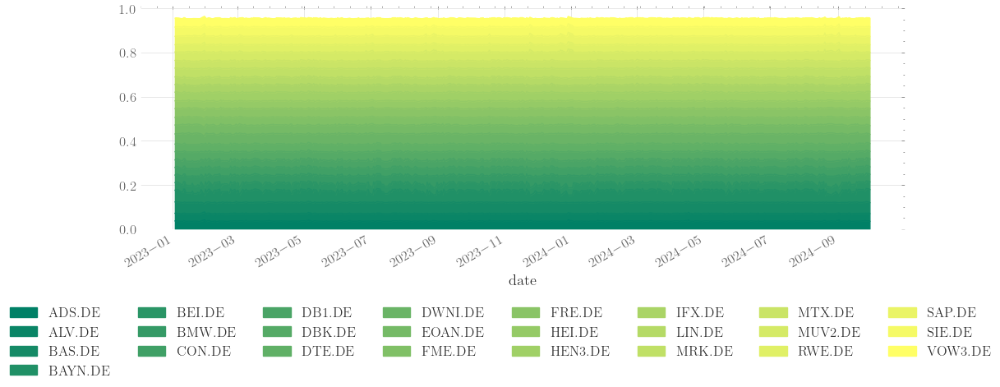

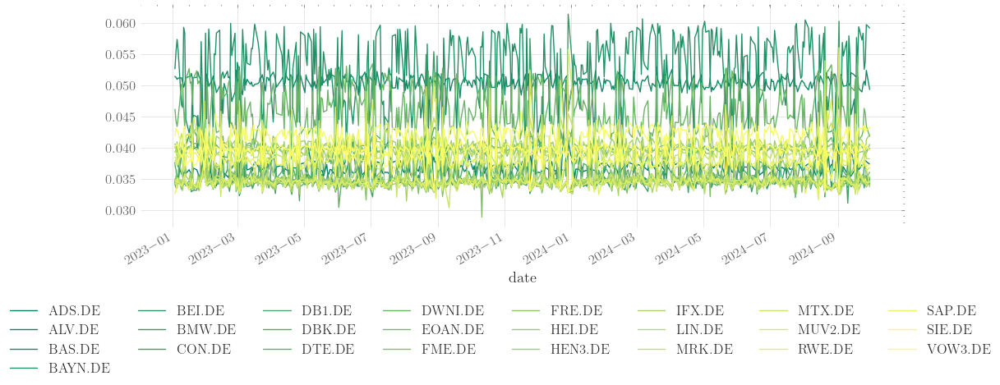

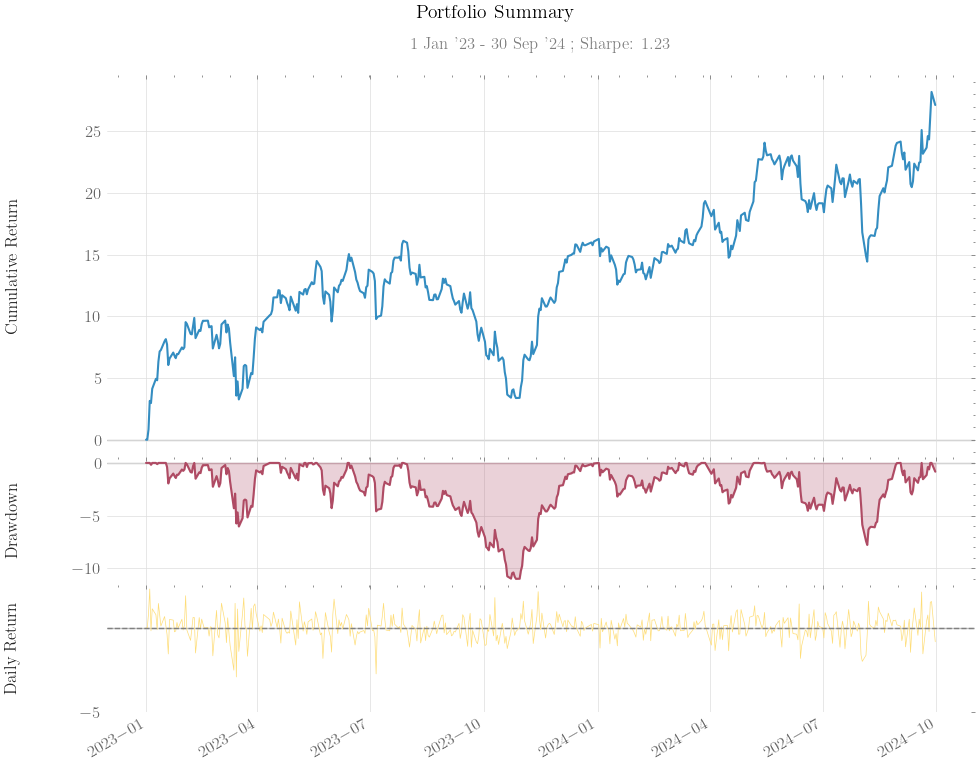

In [5]:
w = pd.DataFrame(ppo_result['test'][0].weights.tolist())
w = w.drop(columns=[0],axis=0)
columns = test_data.tic.unique().tolist()
columns.append('date')
w['date'] = ppo_result['test'][0].date
w.columns = columns
w.iloc[1:,].plot(x='date',figsize=(12,4),kind='area', stacked=True,colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
w.iloc[1:,].plot(x='date',figsize=(12,4),colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))

zz = ppo_result['test'][0]['daily_return']
zz.index=ppo_result['test'][0]['date']
print('max drowdown:', qs.stats.max_drawdown(ppo_result['test'][0].account) , 'Sharp ratio:', qs.stats.sharpe(ppo_result['test'][0].daily_return))
qs.plots.snapshot(zz)


## A2C

In [20]:
from finrl.agents.stablebaselines3.models import DRLAgent

a2c_results= {}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return","turbulence"],
    'comission_fee_pct':0.0025,
    'time_window':1
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)

est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
model_a2c = agent.get_model("a2c")
a2c_model = agent.train_model(model=model_a2c, 
                            tb_log_name='a2c',
                            total_timesteps=100_000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "weights": e_train_gym._final_weights,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
a2c_predictions = DRL_prediction(a2c_model, est,5)
a2c_results["train"] =  metrics_df_dax
a2c_results["test"] =a2c_predictions


{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0007}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------------
| time/                 |              |
|    fps                | 46           |
|    iterations         | 100          |
|    time_elapsed       | 10           |
|    total_timesteps    | 500          |
| train/                |              |
|    entropy_loss       | -38.6        |
|    explained_variance | 0.00341      |
|    learning_rate      | 0.0007       |
|    n_updates          | 99           |
|    policy_loss        | -0.208       |
|    reward             | -0.017103005 |
|    std                | 1.07         |
|    value_loss         | 4.39e-05     |
----------------------------------------
----------------------------------------
| time/                 |              |
|    fps                | 47           |
|    iterations         | 200          |
|    time_elapsed       | 2

max drowdown: -0.11125403010327128 Sharp ratio: 1.260874007915644


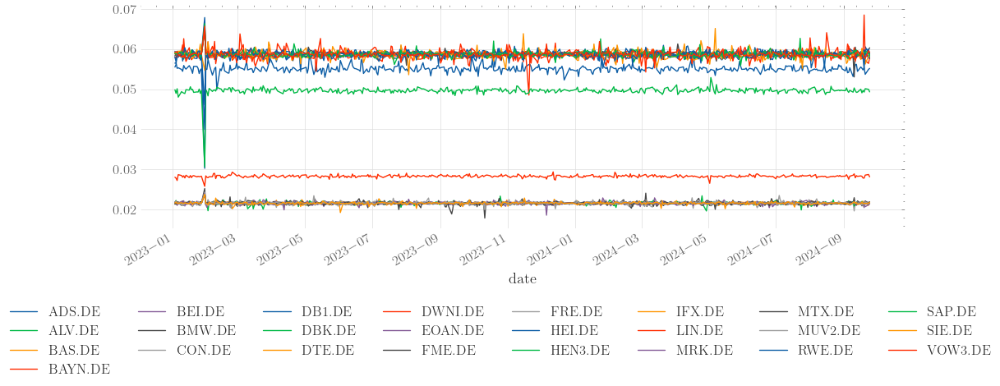

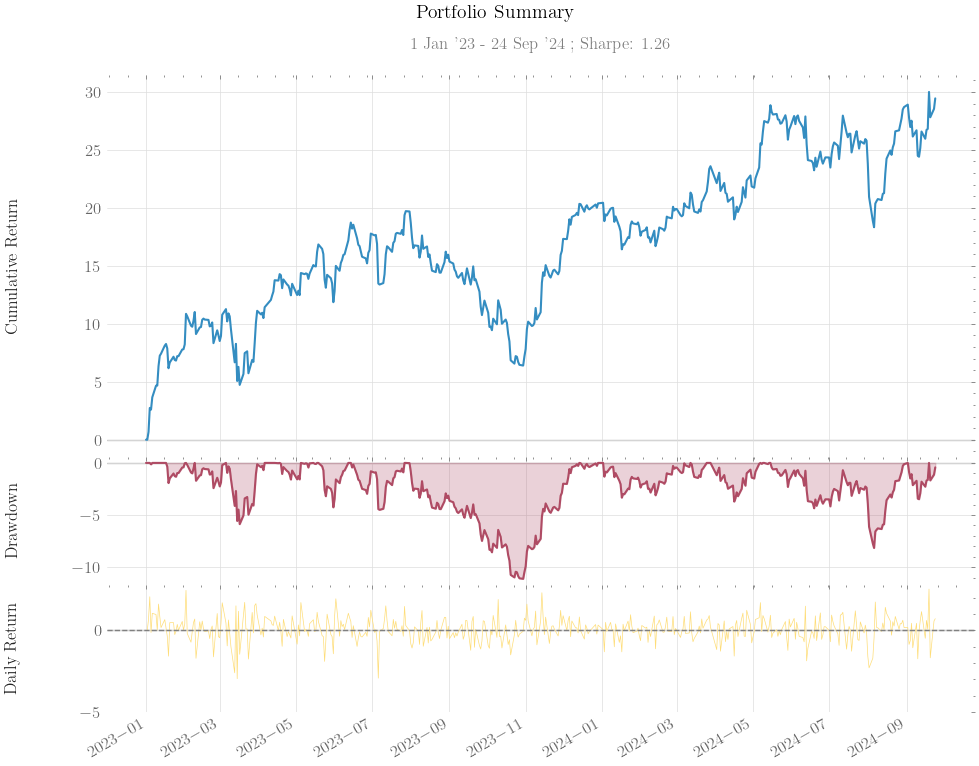

<Axes: xlabel='date'>

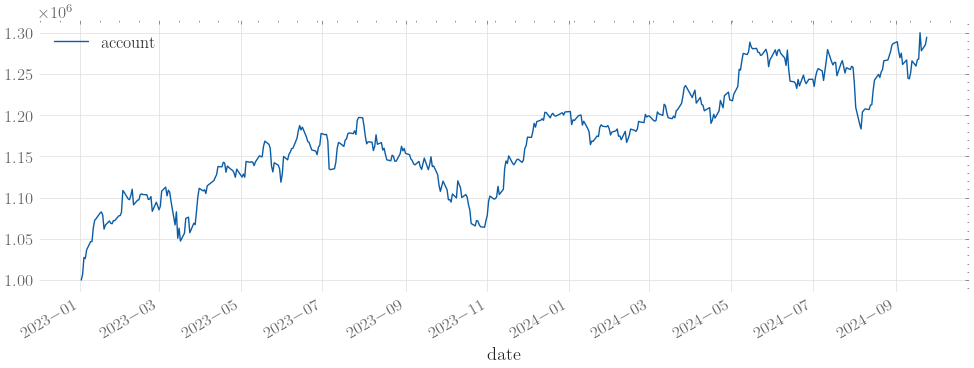

In [21]:
w = pd.DataFrame(a2c_results['test'][0].weights.tolist())
w = w.drop(columns=[0],axis=0)
columns = test_data.tic.unique().tolist()
columns.append('date')
w['date'] = a2c_results['test'][0].date
w.columns = columns
w.iloc[1:,].plot(x='date',figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
zz = a2c_results['test'][0]['daily_return']
zz.index=a2c_results['test'][0]['date']
print('max drowdown:', qs.stats.max_drawdown(a2c_results['test'][0].account) , 'Sharp ratio:', qs.stats.sharpe(a2c_results['test'][0].daily_return))
qs.plots.snapshot(zz)
a2c_results['test'][0].plot(x='date',y='account',figsize=(12,4))

## buy and hold

In [7]:
stock_dimension = len(test_data.tic.unique())

environment_train_buy_and_hold = PortfolioOptimizationEnv(
    test_data,
    initial_amount=1000000,
    comission_fee_pct=0.001,
    time_window=5,
    features = ["close","return"],
    normalize_df=None
)
terminated = False

environment_train_buy_and_hold.reset()

while not terminated:
    action = [0] + [1/stock_dimension] * stock_dimension
    _, _, terminated, _ = environment_train_buy_and_hold.step(
        np.array(action, dtype=np.float32))

Initial portfolio value:1000000
Final portfolio value: 1299162.875
Final accumulative portfolio value: 1.299162875
Maximum DrawDown: -0.10726501672249589
Sharpe ratio: 1.3193694566575573


In [59]:
stock_dimension

28

-0.10726507368948102


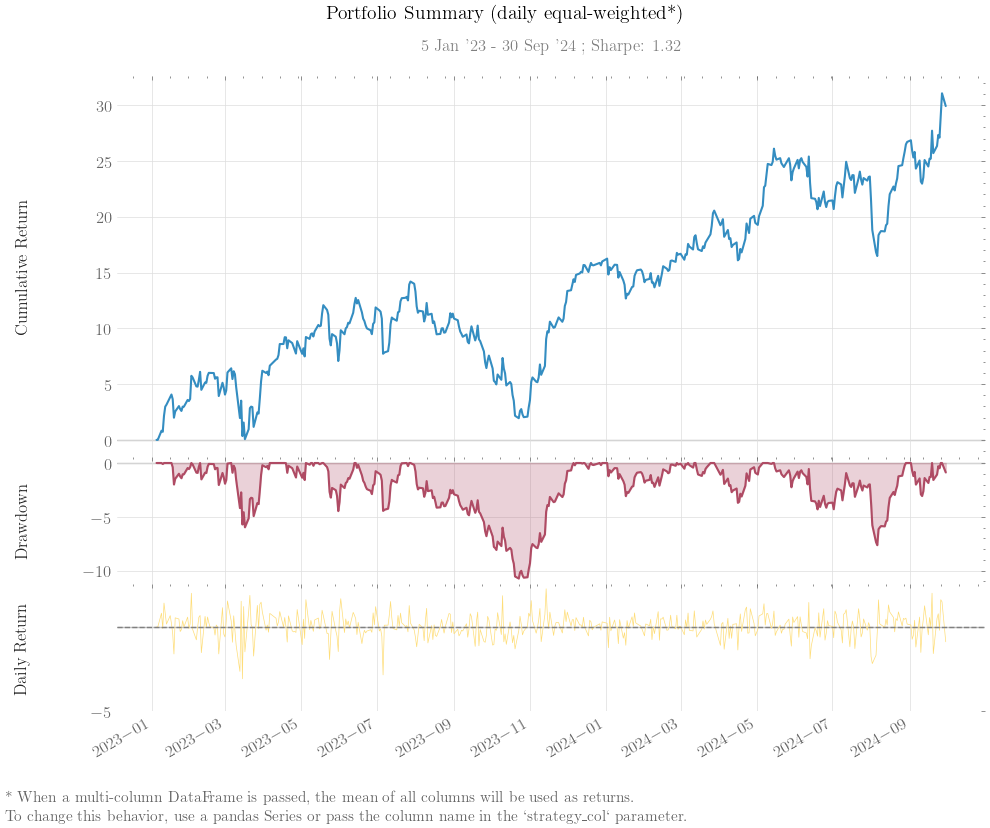

<Axes: >

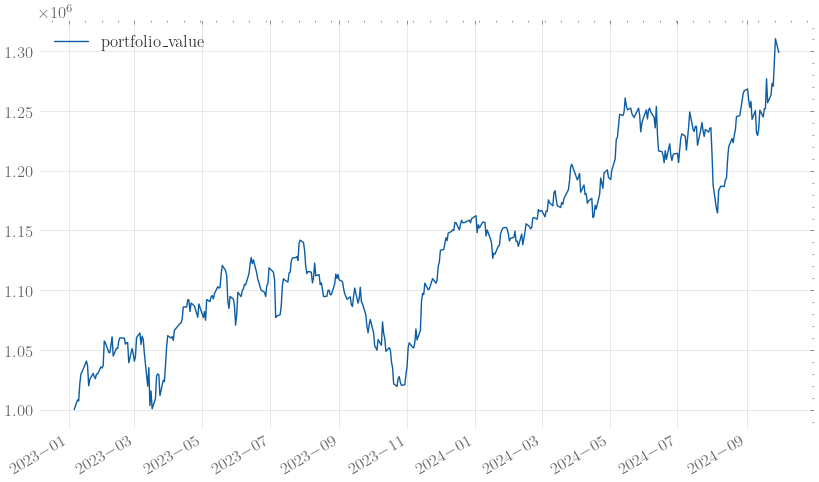

In [10]:
buy_and_hold_train = environment_train_buy_and_hold._asset_memory["final"]
buy_and_hold_weights_train = environment_train_buy_and_hold._final_weights
buy_and_hold_weights_df = pd.DataFrame(buy_and_hold_weights_train)

buy_and_hold_account_df = pd.DataFrame(buy_and_hold_train,environment_train_buy_and_hold._date_memory)

buy_and_hold_weights_df.drop(buy_and_hold_weights_df.columns[0],axis=1,inplace=True)
buy_and_hold_weights_df.columns = test_data.tic.unique()
buy_and_hold_account_df['returns'] = environment_train_buy_and_hold._portfolio_return_memory
buy_and_hold_account_df.columns = ['portfolio_value','returns']
buy_and_hold_account_df.head()
print(qs.stats.max_drawdown(buy_and_hold_account_df['returns']))
qs.plots.snapshot(buy_and_hold_account_df)
%matplotlib inline
buy_and_hold_account_df.plot(figsize=(10,6),y ='portfolio_value')

## MVO

In [24]:
from pypfopt import expected_returns

df = df_dax.copy()
df = df.sort_values(['date', 'tic'], ignore_index=True)
df.index = df.date.factorize()[0]
cov_list = []
mu= []
# look back is one year
lookback = 252
for i in range(lookback, len(df.index.unique())):
    data_lookback = df.loc[i-lookback:i, :]
    price_lookback = data_lookback.pivot_table(
        index='date', columns='tic', values='close')
    return_lookback = price_lookback.pct_change().dropna()
    covs = return_lookback.cov().values
    mu.append(expected_returns.mean_historical_return(price_lookback))
    cov_list.append(covs)
df_cov = pd.DataFrame(
{'time': df.date.unique()[lookback:], 'cov_list': cov_list,'returns':mu})
df = df.merge(df_cov, left_on='date',right_on='time')

In [29]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent

test_df = data_split(
df,
start=TEST_START_DATE,
end=TEST_END_DATE
)

stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.0025,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym)
markowitz_history_df = agent.prediction(e_test_gym)
markowitz_history_df["method"] = "markowitz"


Stock Dimension: 28, State Space: 28
begin_total_asset:1000000
end_total_asset:1296776.1286992428
Sharpe:  1.5682437957588453
Test Finished!
episode_return 1.2967761286992427


In [30]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent


stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.0025,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym,objective='sharp')
markowitz_history_maxsharpe_df = agent.prediction(e_test_gym)
markowitz_history_maxsharpe_df["method"] = "markowitz"


Stock Dimension: 28, State Space: 28
begin_total_asset:1000000
end_total_asset:1346288.228486996
Sharpe:  1.519276327078835
Test Finished!
episode_return 1.346288228486996


Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\selector_events.py", line 115, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\selector_events.py", line 115, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 100

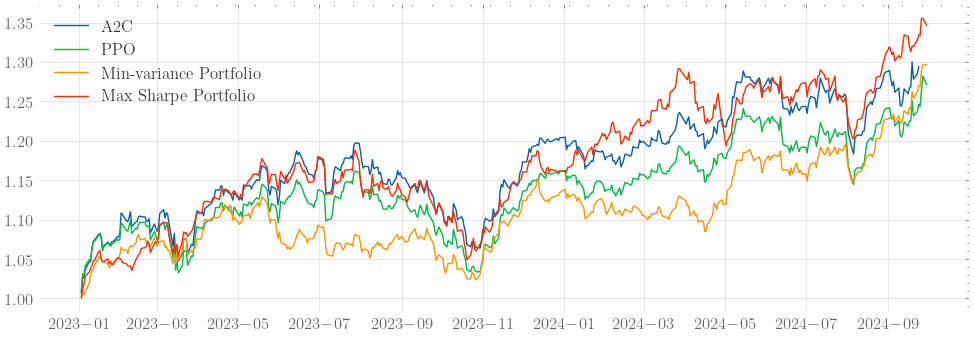

In [28]:
%matplotlib inline

plt.figure(figsize=(12,4))
plt.plot(a2c_results['test'][0].get('date'),(a2c_results['test'][0]['account'].pct_change() + 1).cumprod(),label='A2C')
plt.plot(ppo_result['test'][0].get('date'),(ppo_result['test'][0]['account'].pct_change()+1).cumprod(),label='PPO')
plt.plot(markowitz_history_df.date,(markowitz_history_df.total_assets.pct_change() +1).cumprod(),label= 'Min-variance Portfolio')
plt.plot(markowitz_history_maxsharpe_df.date,(markowitz_history_maxsharpe_df.total_assets.pct_change() +1).cumprod(),label= 'Max Sharpe Portfolio')

plt.legend()
plt.show()


In [11]:
result_dax = {}
with open('./data/dax.pkl','rb') as f:
    result_dax = pickle.load(f)

In [12]:
a2c_results = result_dax['A2C']
ppo_result = result_dax['PPO']
markowitz_history_df = result_dax['MinVar']
markowitz_history_maxsharpe_df = result_dax['MaxSharp']
environment_train_buy_and_hold = result_dax['BH']


## Comparison

KeyError: 'test_df'

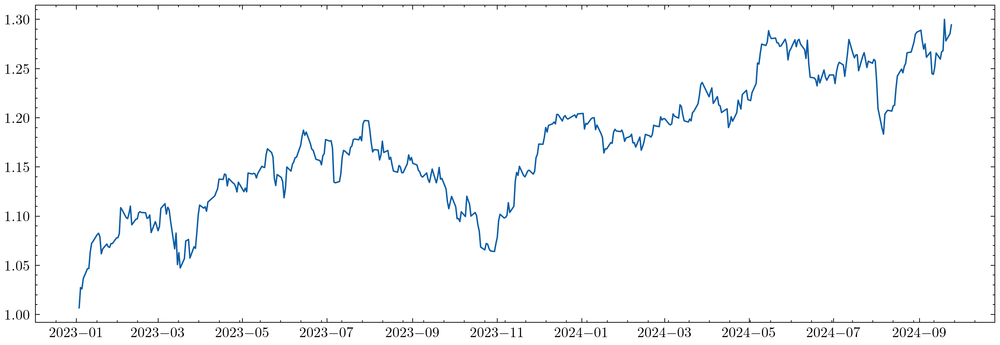

In [22]:
%matplotlib inline

with plt.style.context('science','ieee'):
    plt.figure(figsize=(12,4),dpi=300)
    plt.plot(a2c_results['test'][0].get('date'),(a2c_results['test'][0]['account'].pct_change() +1).cumprod(),label='A2C')
    plt.plot(ppo_result['test_df'][0].get('date'),(ppo_result['test_df'][0]['account'].pct_change() +1).cumprod(),label='PPO')
    plt.plot(markowitz_history_df.date,(markowitz_history_df.total_assets.pct_change() + 1).cumprod(),label='Minimum Variance Portfolio')
    plt.plot(markowitz_history_maxsharpe_df.date,(markowitz_history_maxsharpe_df.total_assets.pct_change() +1).cumprod(),label='Maximum Sharpe Portfolio') 
    plt.plot(environment_train_buy_and_hold._date_memory,(pd.Series(environment_train_buy_and_hold._asset_memory["final"]).pct_change() + 1).cumprod(),label = 'Passive Portfolio')
    plt.legend()
    plt.ylabel('Cumulative Return')
    plt.title('DAX Index Perfromance (28 of 30 Stocks)')
    plt.show()

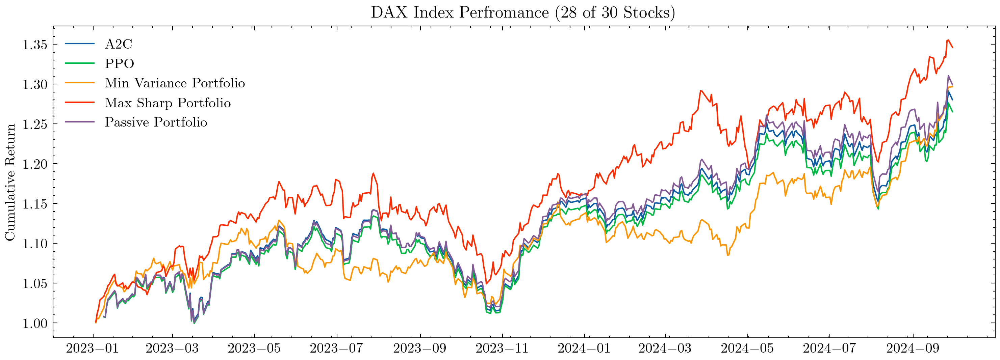

In [97]:
with plt.style.context('science','ieee'):
    plt.figure(figsize=(12,4),dpi=300)
    plt.plot(a2c_results['test'][0].get('date'),(a2c_results['test'][0]['account'].pct_change() +1).cumprod(),label='A2C')
    plt.plot(ppo_result['test'][0].get('date'),(ppo_result['test'][0]['account'].pct_change() +1).cumprod(),label='PPO')
    plt.plot(markowitz_history_df.date,(markowitz_history_df.total_assets.pct_change() + 1).cumprod(),label='Min Variance Portfolio')
    plt.plot(markowitz_history_maxsharpe_df.date,(markowitz_history_maxsharpe_df.total_assets.pct_change() +1).cumprod(),label='Max Sharp Portfolio') 
    plt.plot(environment_train_buy_and_hold._date_memory,(pd.Series(environment_train_buy_and_hold._asset_memory["final"]).pct_change() + 1).cumprod(),label = 'Passive Portfolio')
    plt.legend()
    plt.ylabel('Cumulative Return')
    plt.title('DAX Index Perfromance (28 of 30 Stocks)')
    plt.show()

In [58]:
metric_dow = pd.DataFrame({
    "method" : ['Min-variane', 'Max Sharpe','A2C','PPO','Buy and Hold'],
    "returns": [markowitz_history_df.total_assets[len(markowitz_history_df.total_assets)-1] / markowitz_history_df.total_assets[0],
                markowitz_history_maxsharpe_df.total_assets[len(markowitz_history_maxsharpe_df.total_assets)-1] / markowitz_history_maxsharpe_df.total_assets[0],
                a2c_results['test'][0]['account'][len(a2c_results['test'][0]['account'])-1] / a2c_results['test'][0]['account'][0],
                ppo_result['test'][0]['account'][len(ppo_result['test'][0]['account'])-1] / ppo_result['test'][0]['account'][0],
                environment_train_buy_and_hold._asset_memory["final"][len(environment_train_buy_and_hold._asset_memory["final"])-1] / environment_train_buy_and_hold._asset_memory["final"][0],
                ],
    "Sharp ratio": [ qs.stats.sharpe(markowitz_history_df.total_assets)
                    ,qs.stats.sharpe(markowitz_history_maxsharpe_df.total_assets)
                    ,qs.stats.sharpe(a2c_results['test'][0]['account'])
                    ,qs.stats.sharpe(ppo_result['test'][0]['account'])
                    ,qs.stats.sharpe(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))],
    "Maximum Drowdown": [ 
                     (qs.stats.max_drawdown(markowitz_history_df.total_assets)*100).round(2)
                    ,(qs.stats.max_drawdown(markowitz_history_maxsharpe_df.total_assets) *100).round(2)
                    ,(qs.stats.max_drawdown(a2c_results['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(ppo_result['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))*100).round(2)
                    ]
})
metric_dow

,method,returns,Sharp ratio,Maximum Drowdown
0,Min-variane,1.296776,1.566479,-9.33
1,Max Sharpe,1.346288,1.517568,-11.70
2,A2C,1.280362,1.277772,-11.13
3,PPO,1.265336,1.232556,-10.80
4,Buy and Hold,1.299163,1.319371,-10.73


In [98]:
metric_dow = pd.DataFrame({
    "method" : ['Min-variane', 'Max Sharpe','A2C','PPO','Buy and Hold'],
    "returns": [markowitz_history_df.total_assets[len(markowitz_history_df.total_assets)-1] / markowitz_history_df.total_assets[0],
                markowitz_history_maxsharpe_df.total_assets[len(markowitz_history_maxsharpe_df.total_assets)-1] / markowitz_history_maxsharpe_df.total_assets[0],
                a2c_results['test'][0]['account'][len(a2c_results['test'][0]['account'])-1] / a2c_results['test'][0]['account'][0],
                ppo_result['test'][0]['account'][len(ppo_result['test'][0]['account'])-1] / ppo_result['test'][0]['account'][0],
                environment_train_buy_and_hold._asset_memory["final"][len(environment_train_buy_and_hold._asset_memory["final"])-1] / environment_train_buy_and_hold._asset_memory["final"][0],
                ],
    "Sharp ratio": [ qs.stats.sharpe(markowitz_history_df.total_assets)
                    ,qs.stats.sharpe(markowitz_history_maxsharpe_df.total_assets)
                    ,qs.stats.sharpe(a2c_results['test'][0]['account'])
                    ,qs.stats.sharpe(ppo_result['test'][0]['account'])
                    ,qs.stats.sharpe(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))],
    "Maximum Drowdown": [ 
                     (qs.stats.max_drawdown(markowitz_history_df.total_assets)*100).round(2)
                    ,(qs.stats.max_drawdown(markowitz_history_maxsharpe_df.total_assets) *100).round(2)
                    ,(qs.stats.max_drawdown(a2c_results['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(ppo_result['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))*100).round(2)
                    ]
})
metric_dow

,method,returns,Sharp ratio,Maximum Drowdown
0,Min-variane,1.296776,1.566479,-9.33
1,Max Sharpe,1.346288,1.517568,-11.70
2,A2C,1.280362,1.277772,-11.13
3,PPO,1.265336,1.232556,-10.80
4,Buy and Hold,1.299163,1.319371,-10.73


In [68]:
result_dax = {
    'PPO': ppo_result,
    'A2C': a2c_results,
    'BH': environment_train_buy_and_hold,
    'MinVar': markowitz_history_df ,
    'MaxSharp': markowitz_history_maxsharpe_df,
}
with open('./data/dax.pkl','wb') as f:
    pickle.dump(result_dax,f)

# HSI

The Hang Seng Index is a market-capitalization-weighted stock market index in Hong Kong, adjusted for free float. It tracks and records daily changes in the largest companies listed on the Hong Kong Stock Exchange and serves as the primary indicator of overall market performance in Hong Kong.

Constituents: 82

Exchanges: Hong Kong Stock Exchange

Foundation: July 31, 1964; 60 years ago

Trading symbol: HSI

Weighting method: Capitalization-weighted

## Data Processing

In [83]:
def clean_data(data):
    """
    clean the raw data
    deal with missing values
    reasons: stocks could be delisted, not incorporated at the time step
    :param data: (df) pandas dataframe
    :return: (df) pandas dataframe
    """
    df = data.copy()
    df = df.sort_values(["date", "tic"], ignore_index=True)
    df.index = df.date.factorize()[0]
    merged_closes = df.pivot_table(index="date", columns="tic", values="close")
    merged_closes = merged_closes.dropna(axis=1)
    tics = merged_closes.columns
    df = df[df.tic.isin(tics)]
    # df = data.copy()
    # list_ticker = df["tic"].unique().tolist()
    # only apply to daily level data, need to fix for minute level
    # list_date = list(pd.date_range(df['date'].min(),df['date'].max()).astype(str))
    # combination = list(itertools.product(list_date,list_ticker))

    # df_full = pd.DataFrame(combination,columns=["date","tic"]).merge(df,on=["date","tic"],how="left")
    # df_full = df_full[df_full['date'].isin(df['date'])]
    # df_full = df_full.sort_values(['date','tic'])
    # df_full = df_full.fillna(0)
    return df

In [84]:
df= data_split(df_hsi, '2005.01.01', TEST_END_DATE)


In [91]:
from feature_engineer import FeatureEngineer


INDICATORS = [
    "close_62_ema",
    "close_21_ema",
    "close_5_ema",
]

fe = FeatureEngineer(use_technical_indicator=False,
                     tech_indicator_list = INDICATORS,
                     use_turbulence=False,
                     user_defined_feature = True)

processed = fe.preprocess_data(df)
train_data= data_split(processed,  '2005.01.01', TRAIN_END_DATE)
test_data = data_split(processed, TEST_START_DATE, TEST_END_DATE)
train_data = train_data.rename(columns={'daily_return':'change'})
test_data  = test_data.rename(columns={'daily_return':'change'})


Successfully added user defined features


## PPO

In [103]:

time_windows = [1,5]
 
results_ppo= {}
for i,t in enumerate(time_windows):
    env_kwargs = {
        "initial_amount": 1000000, 
        "normalize_df":None,
        "features" :["close","change"],
        'comission_fee_pct':0.001,
    }
    e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)
    env_kwargs = {
        "initial_amount": 1000000, 
        "normalize_df":None,
        'comission_fee_pct':0.001,
        "features" :["close","change"],
    }

    est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
    agent = DRLAgent(env = e_train_gym)
    PPO_PARAMS = {
        "n_steps": 2048,
        "ent_coef": 0.01,
        "learning_rate": 0.0003,
        "batch_size": 128,
    }
    model_ppo = agent.get_model("ppo"
                                ,model_kwargs = PPO_PARAMS)
    ppo_model = agent.train_model(model=model_ppo, 
                                tb_log_name='ppo',
                                total_timesteps=t * 1)
    metrics_df_dax = pd.DataFrame(
        {
            "date": e_train_gym._date_memory,
            "actions": e_train_gym._actions_memory,
            "weights": e_train_gym._final_weights,
            "returns": e_train_gym._portfolio_return_memory,
            "rewards": e_train_gym._portfolio_reward_memory,
            "portfolio_values": e_train_gym._asset_memory["final"],
        }
    )
    ppo_predictions = DRL_prediction(ppo_model, est,t)
    results_ppo["ppo_"+ str(t)] = {'train_df': metrics_df_dax,'test_df':ppo_predictions, 'model': ppo_model}

{'n_steps': 2048, 'ent_coef': 0.01, 'learning_rate': 0.0003, 'batch_size': 128}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-------------------------------------
| time/              |              |
|    fps             | 32           |
|    iterations      | 1            |
|    time_elapsed    | 63           |
|    total_timesteps | 2048         |
| train/             |              |
|    reward          | -0.007662371 |
-------------------------------------
Initial portfolio value:1000000
Final portfolio value: 1118132.25
Final accumulative portfolio value: 1.11813225
Maximum DrawDown: -0.10882928851258877
Sharpe ratio: 0.7492005977854875
hit end!
{'n_steps': 2048, 'ent_coef': 0.01, 'learning_rate': 0.0003, 'batch_size': 128}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
-------------------------------------
| time/              |              |
|    fps             | 35           |


max drowdown: -0.10882928851258877 Sharp ratio: 0.7492005977854875


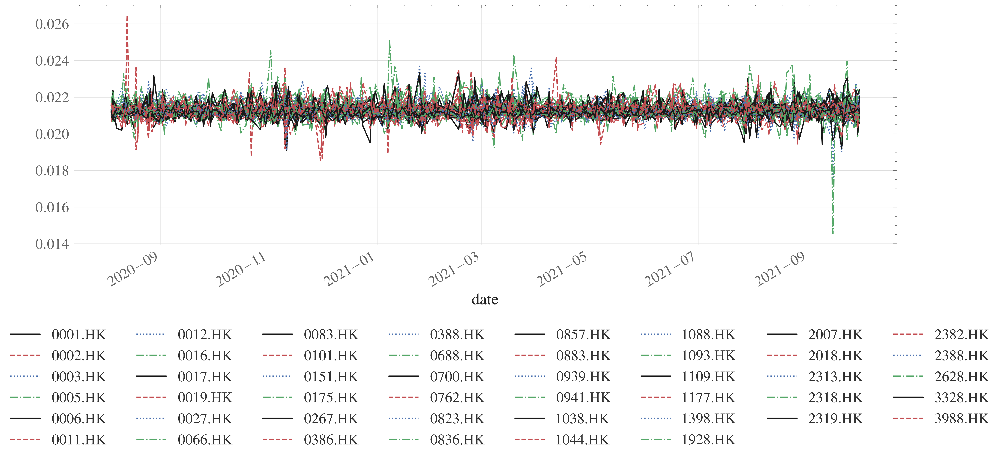

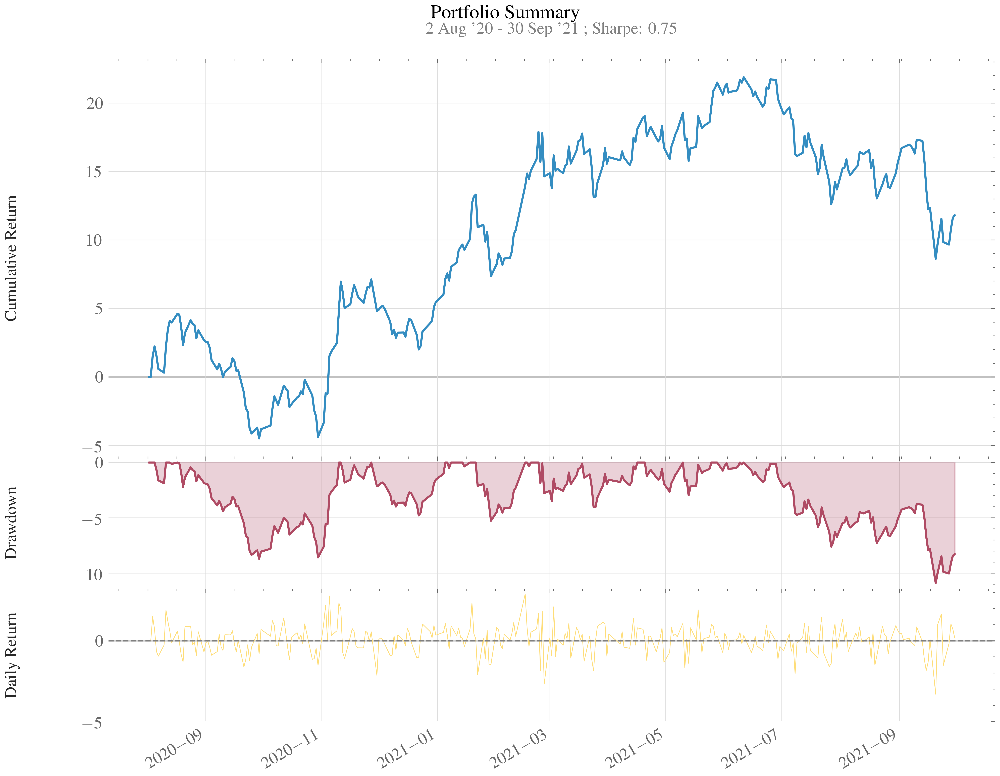

max drowdown: -0.10861104960141721 Sharp ratio: 0.6510361701702719


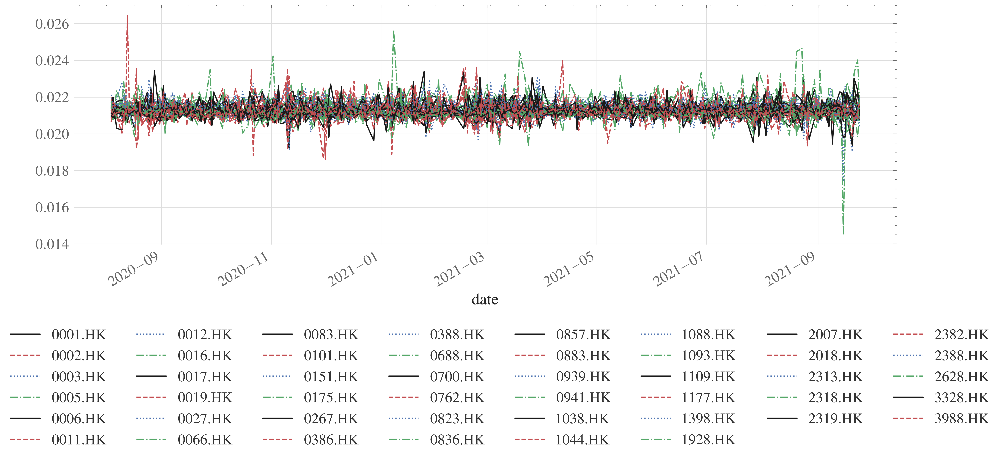

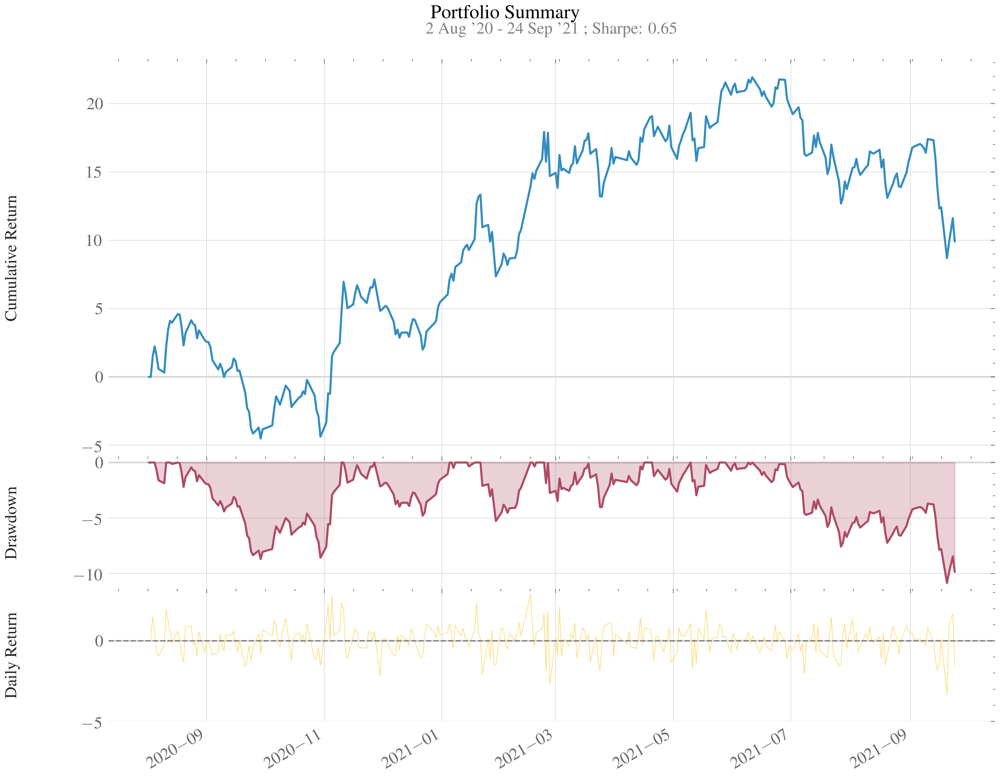

In [105]:
for item in results_ppo:    
    w = pd.DataFrame(results_ppo[item]['test_df'][0].weights.tolist())
    w = w.drop(columns=[0],axis=0)
    columns = test_data.tic.unique().tolist()
    columns.append('date')
    w['date'] = results_ppo[item]['test_df'][0].date
    w.columns = columns
    w.iloc[1:,].plot(x='date',figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
    zz = results_ppo[item]['test_df'][0]['daily_return']
    zz.index=results_ppo[item]['test_df'][0]['date']
    print('max drowdown:', qs.stats.max_drawdown(results_ppo[item]['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results_ppo[item]['test_df'][0].daily_return))
    qs.plots.snapshot(zz)


In [162]:
with open('./models/ppo_hsi.pkl','wb') as f:
    pickle.dump(results,f)

## A2C

In [106]:
from finrl.agents.stablebaselines3.models import DRLAgent

time_windows = [1,5]
 
results= {}
for i,t in enumerate(time_windows):
    env_kwargs = {
        "initial_amount": 1000000, 
        "normalize_df":None,
        "features" :["close","change"],
        'comission_fee_pct':0.001,
    }
    e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)
    env_kwargs = {
        "initial_amount": 1000000, 
        "normalize_df":None,
        'comission_fee_pct':0.001,
        "features" :["close","change"],
    }

    est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
    agent = DRLAgent(env = e_train_gym)
    model_a2c = agent.get_model("a2c")
    a2c_model = agent.train_model(model=model_a2c, 
                                tb_log_name='a2c',
                                total_timesteps=t * 1)
    metrics_df_dax = pd.DataFrame(
        {
            "date": e_train_gym._date_memory,
            "actions": e_train_gym._actions_memory,
            "returns": e_train_gym._portfolio_return_memory,
            "rewards": e_train_gym._portfolio_reward_memory,
            "weights": e_train_gym._final_weights,
            "portfolio_values": e_train_gym._asset_memory["final"],
        }
    )
    a2c_predictions = DRL_prediction(a2c_model, est,t)
    results["a2c_"+ str(t)] = {'train_df': metrics_df_dax,'test_df':a2c_predictions}

{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0007}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Initial portfolio value:1000000
Final portfolio value: 1119253.5
Final accumulative portfolio value: 1.1192535
Maximum DrawDown: -0.1086874150324828
Sharpe ratio: 0.7550704712220893
hit end!
{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0007}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
Initial portfolio value:1000000
Final portfolio value: 1118882.25
Final accumulative portfolio value: 1.11888225
Maximum DrawDown: -0.10871805152712188
Sharpe ratio: 0.7531012418636219
hit end!


max drowdown: -0.1086874150324828 Sharp ratio: 0.7550704712220893


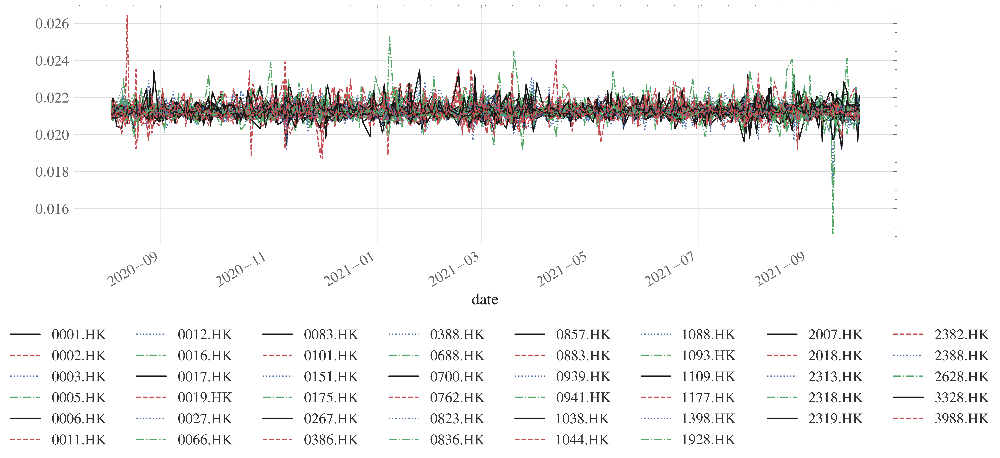

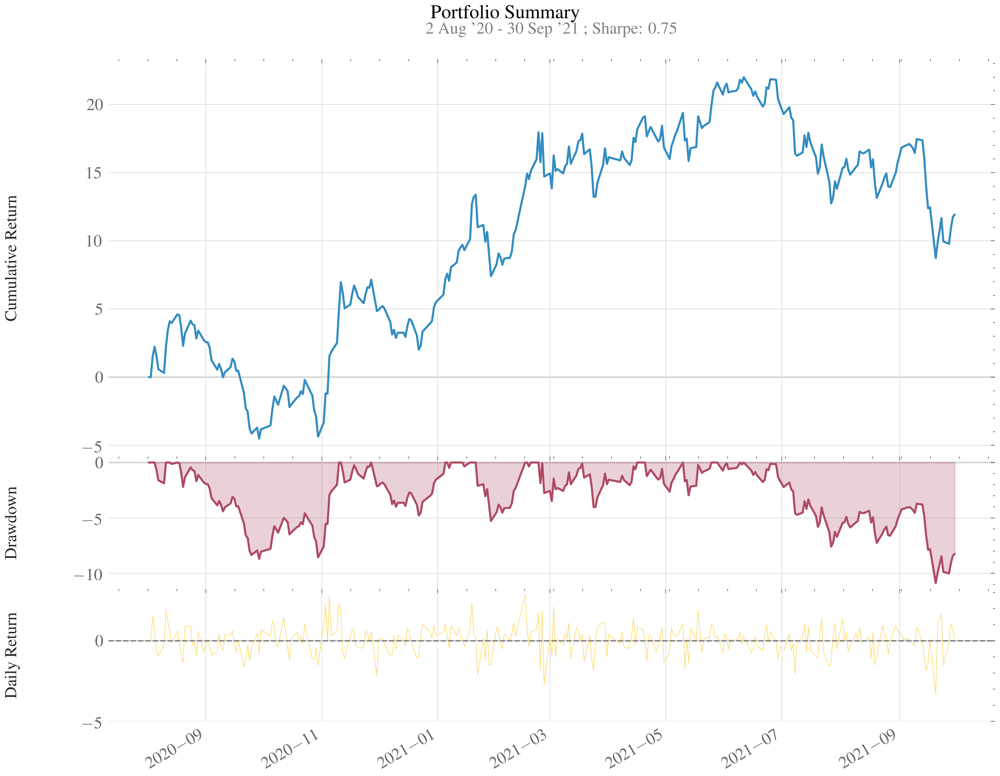

max drowdown: -0.10871805152712188 Sharp ratio: 0.6515771079677835


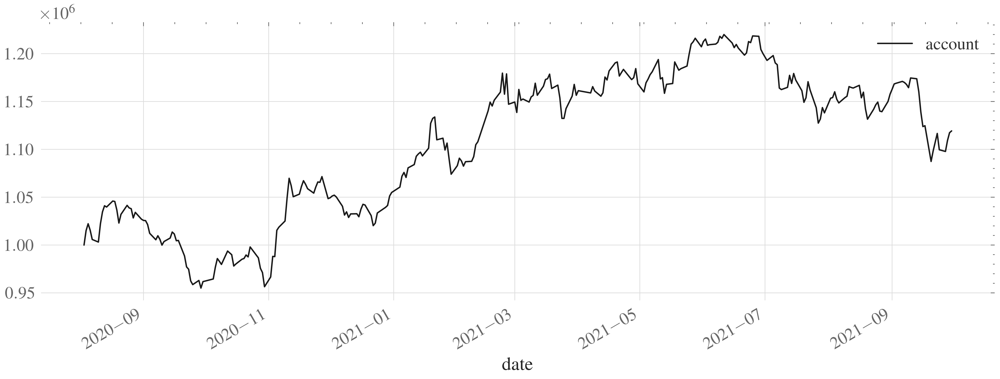

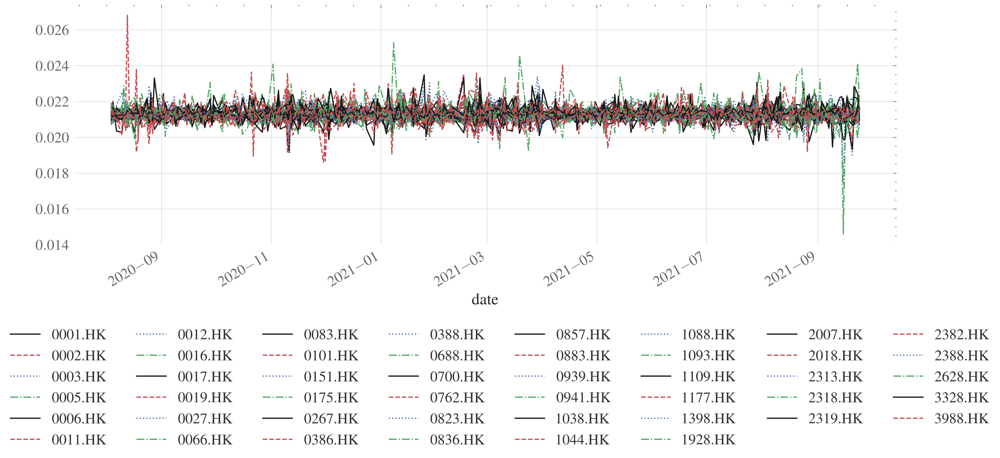

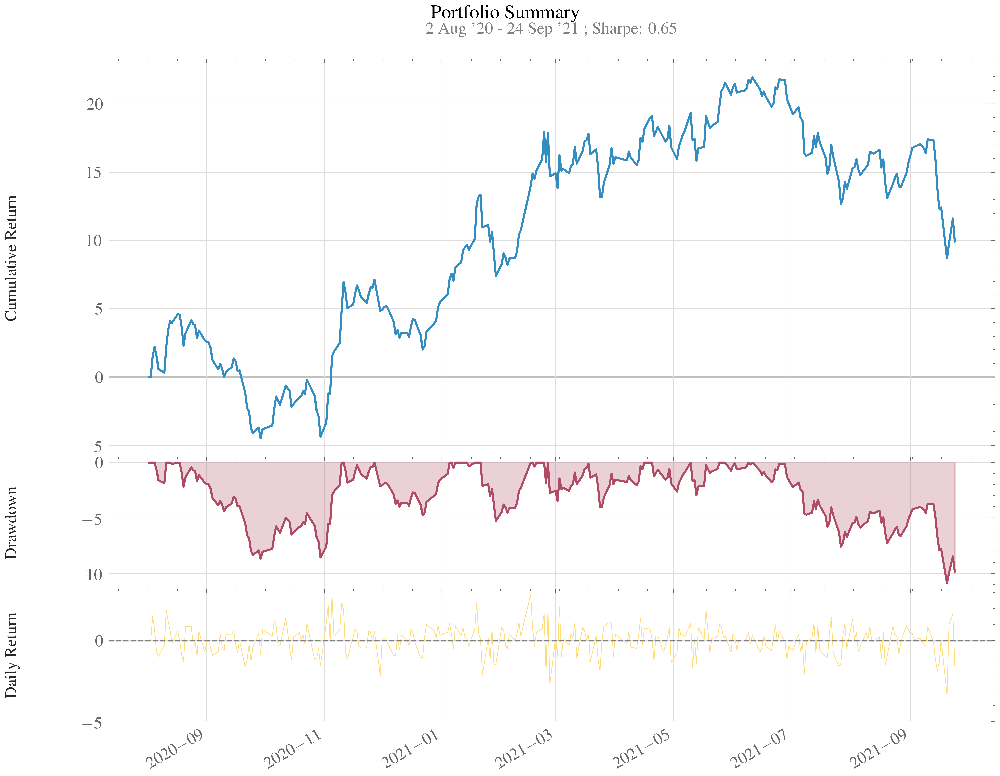

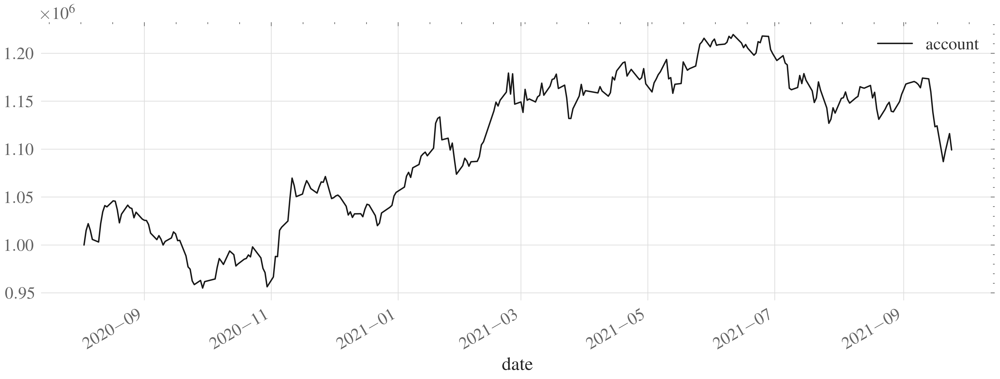

In [107]:
for v,item in enumerate(results):    
    w = pd.DataFrame(results[item]['test_df'][0].weights.tolist())
    w = w.drop(columns=[0],axis=0)
    columns = test_data.tic.unique().tolist()
    columns.append('date')
    w['date'] = results[item]['test_df'][0].date
    w.columns = columns
    w.iloc[1:,].plot(x='date',figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
    zz = results[item]['test_df'][0]['daily_return']
    zz.index=results[item]['test_df'][0]['date']
    print('max drowdown:', qs.stats.max_drawdown(results[item]['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results[item]['test_df'][0].daily_return))
    qs.plots.snapshot(zz)
    results[item]['test_df'][0].plot(x='date',y='account',figsize=(12,4))

In [164]:
with open('./models/a2c_hsi.pkl','wb') as f:
    pickle.dump(results,f)

## MVO

In [96]:
intervals = [50,120,252]
history = []
# add covariance matrix as states
for i,interval in enumerate(intervals):
    df = df_hsi.copy()
    df = df.sort_values(['date', 'tic'], ignore_index=True)
    df.index = df.date.factorize()[0]

    df["pct_change"] = df.groupby("tic").close.pct_change()

    cov_list = []
    # look back is one year
    lookback = 252
    for i in range(lookback, len(df.index.unique())):
        data_lookback = df.loc[i-lookback:i, :]
        price_lookback = data_lookback.pivot_table(
            index='date', columns='tic', values='close')
        return_lookback = price_lookback.pct_change().dropna()
        covs = return_lookback.cov().values
        cov_list.append(covs)
    # df = df.sort_values(by=['tic', 'date'])  # Sort to ensure proper order
    # df['expected_return'] = df.groupby('tic')['pct_change'].ewm(span=50).mean().reset_index(level=0, drop=True)
    df["ewm_returns"] = df["pct_change"].ewm(span=interval).mean()
    df["mean_pct_change_lookback"] = df.rolling(lookback)["pct_change"].mean()
    df_cov = pd.DataFrame(
        {'time': df.date.unique()[lookback:], 'cov_list': cov_list})
    df = df.merge(df_cov, left_on='date',right_on='time')
    df = df.sort_values(['date', 'tic']).reset_index(drop=True)

    from agents.evn_mvo import StockPortfolioEnv
    from agents.mvo_agent import MarkowitzAgent


    test_df = data_split(
        df,
        start=TEST_START_DATE,
        end=TEST_END_DATE
    )

    stock_dimension = len(test_df.tic.unique())
    state_space = stock_dimension
    print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

    env_kwargs = {
        "hmax": 100,
        "initial_amount": 1000000,
        "transaction_cost_pct": 0.0025,
        "state_space": state_space,
        "stock_dim": stock_dimension,
        "tech_indicator_list": INDICATORS,
        "action_space": stock_dimension,
        "reward_scaling": 1e-4

    }
    e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
    agent = MarkowitzAgent(e_test_gym)
    markowitz_history_df = agent.prediction(e_test_gym)
    markowitz_history_df["method"] = "markowitz"
    history.append({"mvo_"+str(interval) : markowitz_history_df})

Stock Dimension: 50, State Space: 50
begin_total_asset:1000000
end_total_asset:993782.0849544011
Sharpe:  0.04376232765441028
Test Finished!
episode_return 0.9937820849544011
Stock Dimension: 50, State Space: 50
begin_total_asset:1000000
end_total_asset:920491.058132343
Sharpe:  -0.4749040947845907
Test Finished!
episode_return 0.920491058132343
Stock Dimension: 50, State Space: 50
begin_total_asset:1000000
end_total_asset:1033586.1134871426
Sharpe:  0.29114462360207777
Test Finished!
episode_return 1.0335861134871427


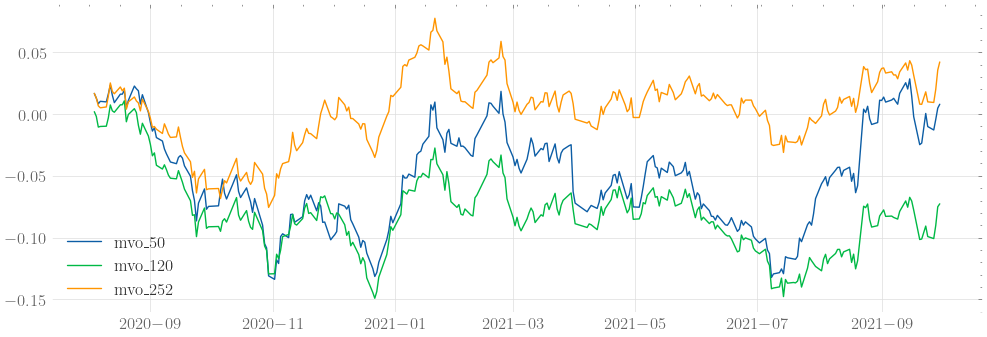

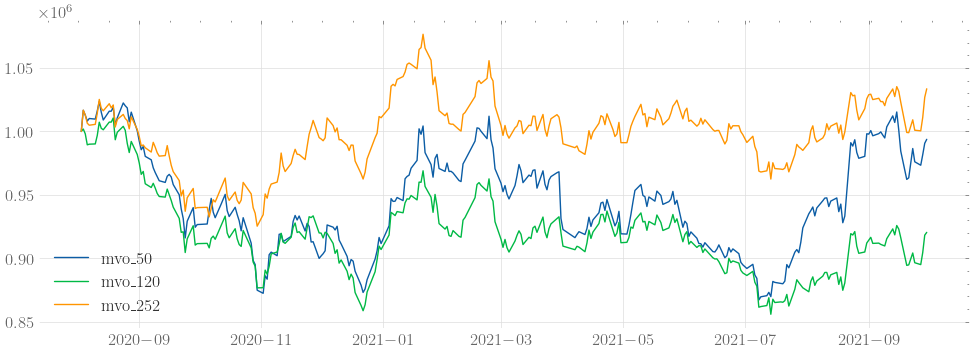

In [97]:
plt.figure(figsize=(12,4))
for item in history:    
    key = list(item.keys())[0]
    plt.plot(item[key].date,item[key].total_assets.pct_change().cumsum(),label = key)
plt.legend()
plt.show()
plt.figure(figsize=(12,4))
for item in history:    
    key = list(item.keys())[0]
    plt.plot(item[key].date,item[key].total_assets,label = key)
plt.legend()
plt.show()

## Buy and Hold

In [98]:
stock_dimension = len(test_data.tic.unique())

environment_train_buy_and_hold = PortfolioOptimizationEnv(
    test_data,
    initial_amount=1000000,
    comission_fee_pct=0.0025,
    time_window=5,
    features = ["close", "high", "low"],
    normalize_df=None
)
terminated = False

environment_train_buy_and_hold.reset()

while not terminated:
    action = [0] + [1/stock_dimension] * stock_dimension
    _, _, terminated, _ = environment_train_buy_and_hold.step(
        np.array(action, dtype=np.float32))

Initial portfolio value:1000000
Final portfolio value: 1109271.5
Final accumulative portfolio value: 1.1092715
Maximum DrawDown: -0.11219030587418843
Sharpe ratio: 0.6983627645587686


-0.1121906211495941


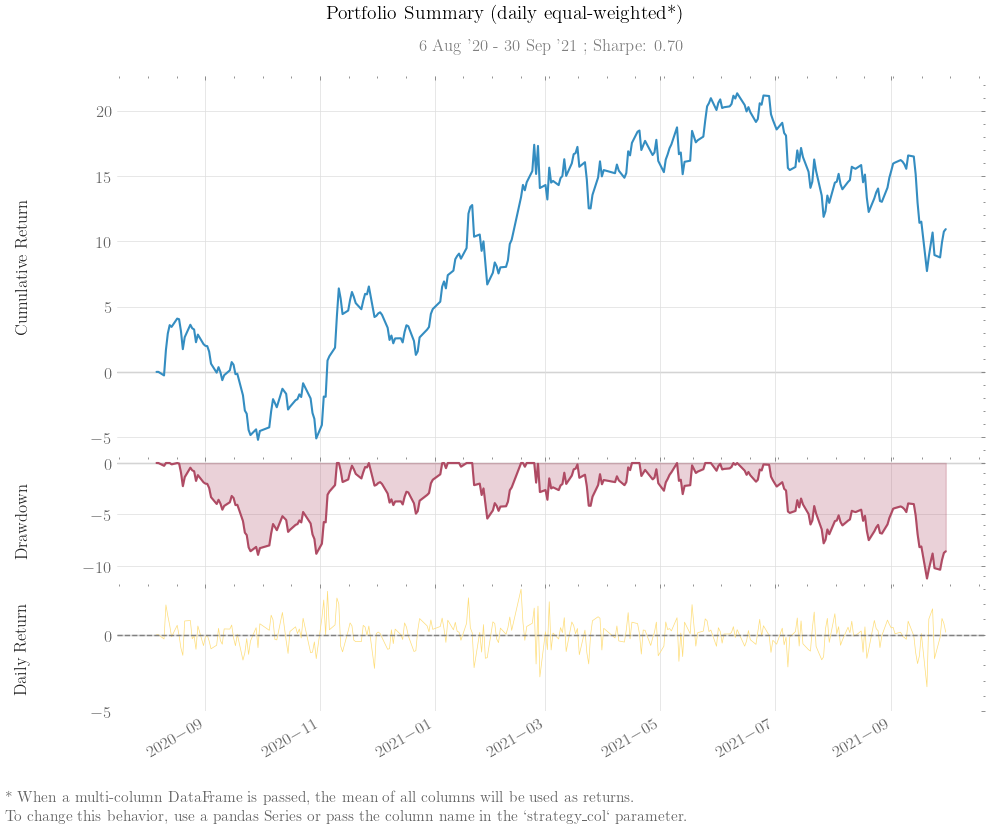

-0.1121906211495941


<Axes: >

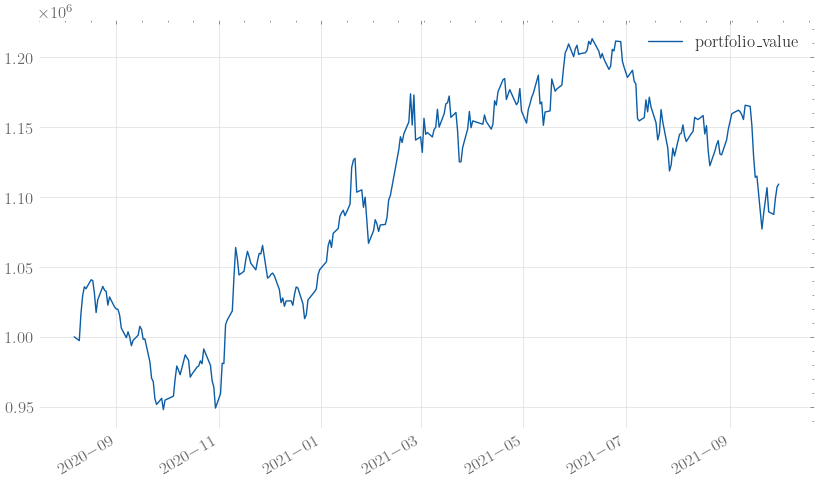

In [99]:
buy_and_hold_train = environment_train_buy_and_hold._asset_memory["final"]
buy_and_hold_weights_train = environment_train_buy_and_hold._final_weights
buy_and_hold_weights_df = pd.DataFrame(buy_and_hold_weights_train)

buy_and_hold_account_df = pd.DataFrame(buy_and_hold_train,environment_train_buy_and_hold._date_memory)

buy_and_hold_weights_df.drop(buy_and_hold_weights_df.columns[0],axis=1,inplace=True)
buy_and_hold_weights_df.columns = test_data.tic.unique()
buy_and_hold_account_df['returns'] = environment_train_buy_and_hold._portfolio_return_memory
buy_and_hold_account_df.columns = ['portfolio_value','returns']
buy_and_hold_account_df.head()
print(qs.stats.max_drawdown(buy_and_hold_account_df['returns']))
qs.plots.snapshot(buy_and_hold_account_df)
print(qs.stats.max_drawdown(buy_and_hold_account_df['returns']))
%matplotlib inline
buy_and_hold_account_df.plot(figsize=(10,6),y ='portfolio_value')

In [280]:
results_ppo = None
with open('./models/ppo_hsi.pkl','rb') as f:
    results_ppo = pickle.load(f)

In [287]:
with open('./models/a2c_hsi.pkl','rb') as f:
    results_a2c = pickle.load(f)

## Comparison

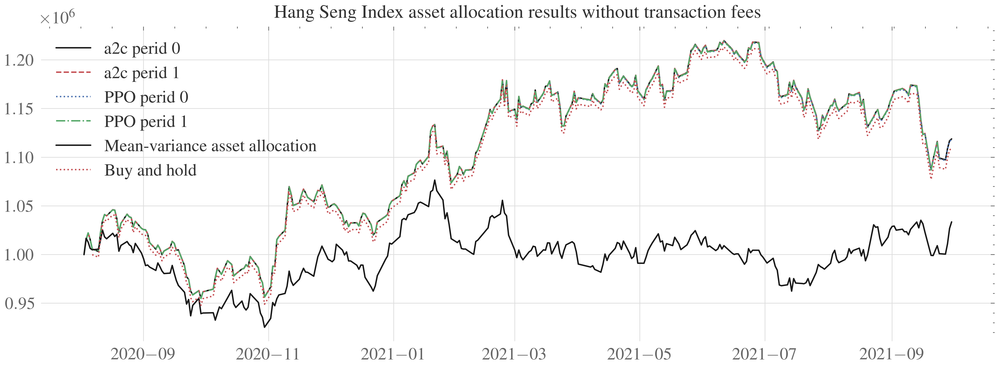

In [104]:
plt.style.use(['science','ieee'])
plt.figure(figsize=(12,4))
for i,item in enumerate(results):    
    plt.plot(results[item]['test_df'][0].get('date'),results[item]['test_df'][0].get('account'),label='a2c perid '+ str(i))
for i,item in enumerate(results_ppo):    
    plt.plot(results_ppo[item]['test_df'][0].get('date'),results_ppo[item]['test_df'][0].get('account'),label='PPO Iter: '+ str(i))
plt.plot(markowitz_history_df.get('date'),markowitz_history_df.get('total_assets'),label='Mean-variance asset allocation')
plt.plot(environment_train_buy_and_hold._date_memory,environment_train_buy_and_hold._asset_memory["final"],label = 'Buy and hold',linestyle = 'dotted')
plt.legend()
plt.title('Hang Seng Index asset allocation results')
plt.show()

# S&P 500

In [47]:
sp500 = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = np.random.choice(SP_500_TICKER,15,replace=True)).fetch_data()

[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['INFO']: YFChartError("%ticker%: Data doesn't exist for startDate = 946702800, endDate = 1727755200")
[*********************100%%**********************]  1 of 1 completed

1 Failed download:
['ADS']: YFTzMissingError('$%ticker%: possibly delisted; No timezone found')
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[********************

Shape of DataFrame:  (73576, 8)


In [48]:
sp500.tic.unique()

array(['ADBE', 'DOV', 'KLAC', 'MCK', 'NKTR', 'NTAP', 'PFE', 'RJF', 'XOM',
       'GPN', 'ICE', 'UAL', 'UA'], dtype=object)

In [49]:
df = sp500

In [50]:
INDICATORS = [
    "close_5_ema",
]
fe = FeatureEngineer(use_technical_indicator=True,
                     tech_indicator_list = INDICATORS,
                     use_turbulence=False,
                     user_defined_feature =True)

processed = fe.preprocess_data(df)
processed = processed.fillna(0)
processed= processed.replace(np.inf,0)
train_data= data_split(processed, TRAIN_START_DATE, TRAIN_END_DATE)
test_data = data_split(processed, TEST_START_DATE, TEST_END_DATE)
# train_data = train_data.rename(columns={'daily_return':'change'})
# test_data  = test_data.rename(columns={'daily_return':'change'})
train_data

Successfully added technical indicators
Successfully added user defined features


,date,open,high,low,close,volume,tic,day,close_5_ema,return
0,2000-01-03,16.812500,16.875000,16.062500,16.274670,7384400,ADBE,0,16.274670,-0.083889
0,2000-01-03,29.997520,30.123207,29.243393,18.590876,730380,DOV,0,18.590876,-0.083889
0,2000-01-03,56.125000,56.125000,51.687500,28.864363,3769400,KLAC,0,28.864363,-0.083889
0,2000-01-03,23.000000,23.625000,22.187500,19.324833,1810300,MCK,0,19.324833,-0.083889
0,2000-01-03,21.437500,21.500000,20.375000,20.843750,107600,NKTR,0,20.843750,-0.083889
...,...,...,...,...,...,...,...,...,...,...
5785,2022-12-29,2.120000,2.240000,2.120000,2.200000,1723300,NKTR,3,2.192048,0.062802
5785,2022-12-29,58.669998,60.369999,58.529999,57.514732,1075500,NTAP,3,56.845050,0.032829
5785,2022-12-29,51.020000,51.669998,50.990002,46.273537,8971300,PFE,3,46.258698,0.010433
5785,2022-12-29,106.919998,108.160004,106.449997,105.020607,750800,RJF,3,104.138330,0.016281


In [51]:
len(df.tic.unique())

13

<Axes: xlabel='date'>

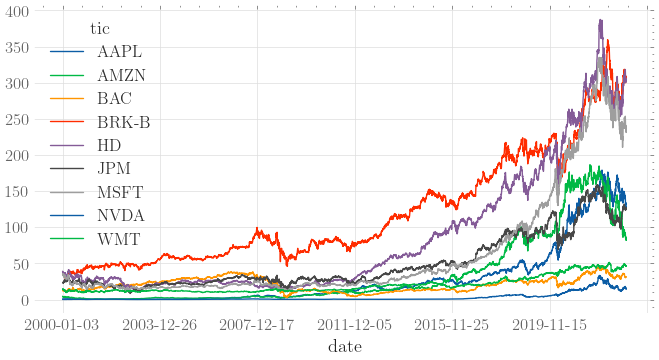

In [68]:
pv = train_data.pivot(values='close',columns='tic',index='date')
pv.plot(figsize=(8,4))

## PPO

In [59]:

results_ppo ={}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return"],
    'comission_fee_pct':0.001,
    'time_window':5
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)
est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
PPO_PARAMS = {
    "n_steps": 2048,
    "ent_coef": 0.01,
    "learning_rate": 0.0003,
    "batch_size": 128,
}
model_ppo = agent.get_model("ppo"
                            ,model_kwargs = PPO_PARAMS)
ppo_model = agent.train_model(model=model_ppo, 
                            tb_log_name='ppo',
                            total_timesteps=50_000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "weights": e_train_gym._final_weights,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
ppo_predictions = DRL_prediction(ppo_model, est,5)
results_ppo["train"] =  metrics_df_dax
results_ppo["test"] =ppo_predictions
# w = pd.DataFrame(results_ppo['test'][0].weights.tolist())
# w = w.drop(columns=[0],axis=0)
# columns = test_data.tic.unique().tolist()
# columns.append('date')
# w['date'] = results_ppo['test_df'][0].date
# w.columns = columns
# w.iloc[1:,].plot(x='date',figsize=(12,4),kind='area', stacked=True).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
# w.iloc[1:,].plot(x='date',figsize=(12,4)).legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))

# zz = results_ppo['test_df'][0]['daily_return']
# zz.index=results_ppo['test_df'][0]['date']
# print('max drowdown:', qs.stats.max_drawdown(results_ppo['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results_ppo['test_df'][0].daily_return))
# qs.plots.snapshot(zz)
plt.show()


{'n_steps': 2048, 'ent_coef': 0.01, 'learning_rate': 0.0003, 'batch_size': 128}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
--------------------------------------
| time/              |               |
|    fps             | 57            |
|    iterations      | 1             |
|    time_elapsed    | 35            |
|    total_timesteps | 2048          |
| train/             |               |
|    reward          | -0.0024043592 |
--------------------------------------
-----------------------------------------
| time/                   |             |
|    fps                  | 56          |
|    iterations           | 2           |
|    time_elapsed         | 72          |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.003424862 |
|    clip_fraction        | 0.00591     |
|    clip_range           | 0.2         |
|    entropy_loss         | -14.2       |
|    explain

In [16]:
zz = results_ppo['test_df'][0]['daily_return']
zz.index=results_ppo['test_df'][0]['date']
# print('max drowdown:', qs.stats.max_drawdown(results_ppo['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results_ppo['test_df'][0].daily_return))
# qs.plots.snapshot(zz)

## A2C

In [58]:

results_a2c= {}
env_kwargs = {
    "initial_amount": 1000000, 
    "normalize_df":None,
    "features" :["close","return"],
    'comission_fee_pct':0.001,
    'time_window':5
}
e_train_gym = PortfolioOptimizationEnv(df = train_data, **env_kwargs)

est = PortfolioOptimizationEnv(df = test_data, **env_kwargs)
agent = DRLAgent(env = e_train_gym)
model_a2c = agent.get_model("a2c")
a2c_model = agent.train_model(model=model_a2c, 
                            tb_log_name='a2c',
                            total_timesteps=50_000)
metrics_df_dax = pd.DataFrame(
    {
        "date": e_train_gym._date_memory,
        "actions": e_train_gym._actions_memory,
        "returns": e_train_gym._portfolio_return_memory,
        "rewards": e_train_gym._portfolio_reward_memory,
        "weights": e_train_gym._final_weights,
        "portfolio_values": e_train_gym._asset_memory["final"],
    }
)
a2c_predictions = DRL_prediction(a2c_model, est,5)
results_a2c["train"] =  metrics_df_dax
results_a2c["test"] =a2c_predictions



{'n_steps': 5, 'ent_coef': 0.01, 'learning_rate': 0.0007}
Using cuda device
Wrapping the env with a `Monitor` wrapper
Wrapping the env in a DummyVecEnv.
----------------------------------------
| time/                 |              |
|    fps                | 44           |
|    iterations         | 100          |
|    time_elapsed       | 11           |
|    total_timesteps    | 500          |
| train/                |              |
|    entropy_loss       | -14.5        |
|    explained_variance | -1.64        |
|    learning_rate      | 0.0007       |
|    n_updates          | 99           |
|    policy_loss        | 0.0358       |
|    reward             | 0.0017667888 |
|    std                | 1.03         |
|    value_loss         | 0.000169     |
----------------------------------------
----------------------------------------
| time/                 |              |
|    fps                | 46           |
|    iterations         | 200          |
|    time_elapsed       | 2

In [25]:
results_a2c= {}
a2c_predictions = DRL_prediction(a2c_model, est,5)
results_a2c["train"] =  metrics_df_dax
results_a2c["test"] =a2c_predictions


Initial portfolio value:1000000
Final portfolio value: 1865015.75
Final accumulative portfolio value: 1.86501575
Maximum DrawDown: -0.09796310045080969
Sharpe ratio: 2.708738824833596
hit end!


max drowdown: -0.139822475252952 Sharp ratio: 0.5386045093115693


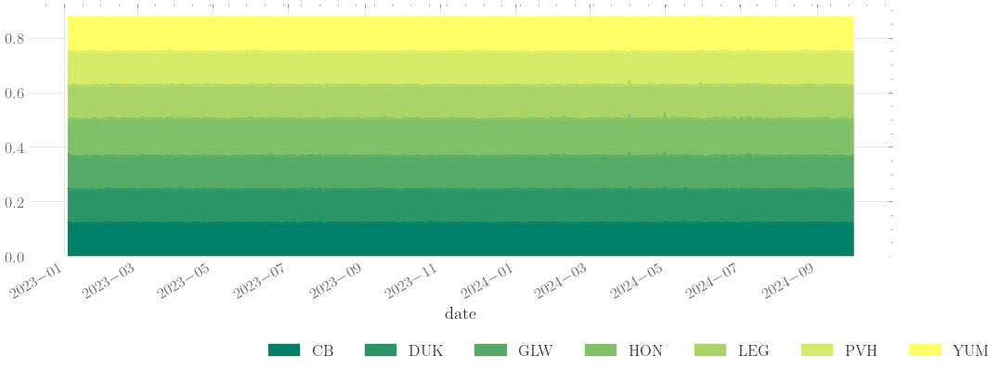

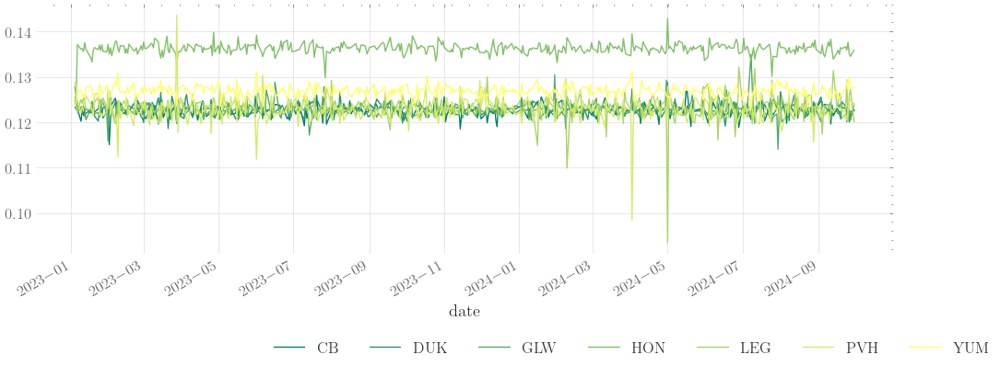

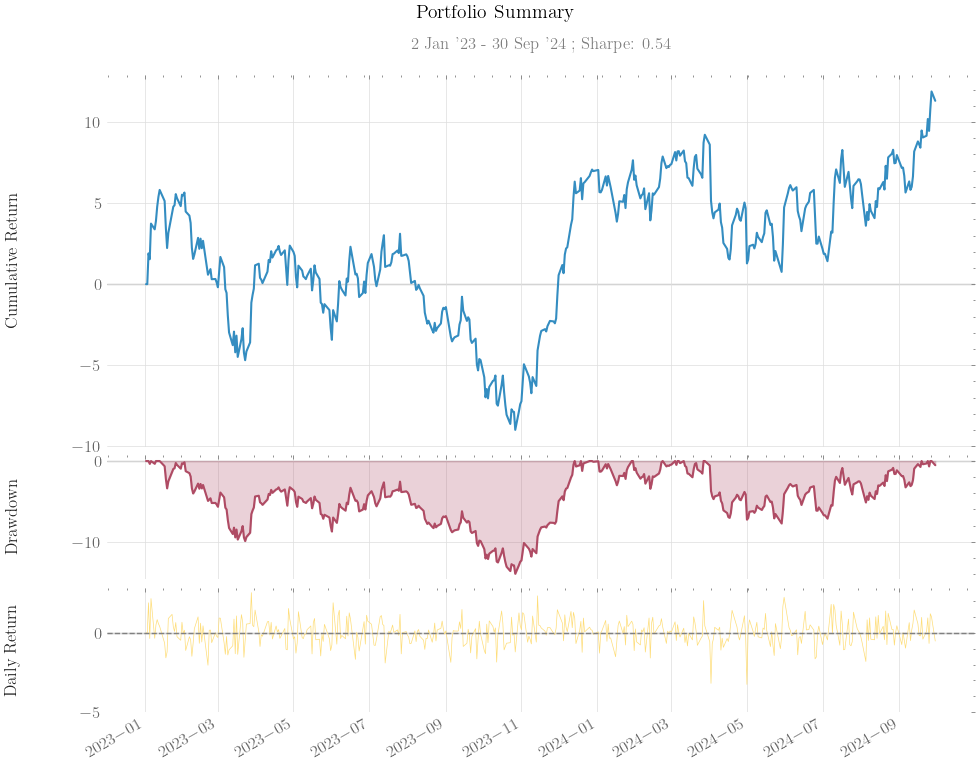

<Axes: xlabel='date'>

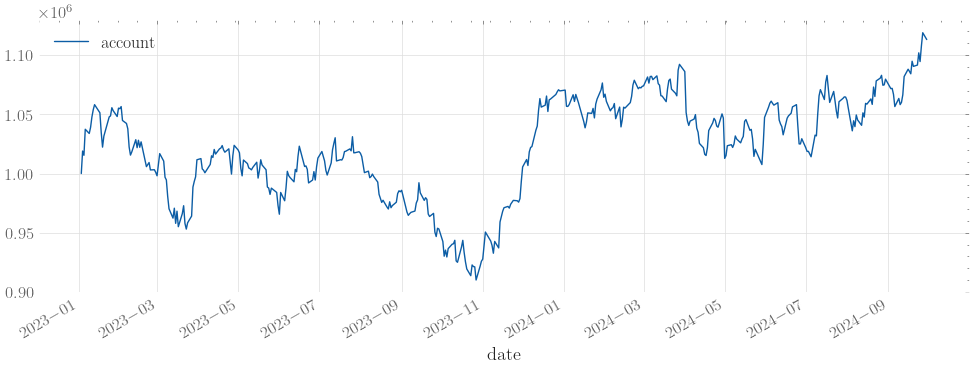

In [55]:
w = pd.DataFrame(results['test_df'][0].weights.tolist())
w = w.drop(columns=[0],axis=0)
columns = test_data.tic.unique().tolist()
columns.append('date')
w['date'] = results['test_df'][0].date
w.columns = columns
w.iloc[1:,].plot(x='date',figsize=(12,4),kind='area', stacked=True,colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
w.iloc[1:,].plot(x='date',figsize=(12,4),colormap="summer").legend(ncol=8,bbox_transform=plt.gcf().transFigure, bbox_to_anchor=(1,0))
zz = results['test_df'][0]['daily_return']
zz.index=results['test_df'][0]['date']
print('max drowdown:', qs.stats.max_drawdown(results['test_df'][0].account) , 'Sharp ratio:', qs.stats.sharpe(results['test_df'][0].daily_return))
qs.plots.snapshot(zz)
results['test_df'][0].plot(x='date',y='account',figsize=(12,4))

## MVO

In [52]:
from pypfopt import expected_returns

df = df.sort_values(['date', 'tic'], ignore_index=True)
df.index = df.date.factorize()[0]
cov_list = []
mu= []
# look back is one year
lookback = 252
for i in range(lookback, len(df.index.unique())):
    data_lookback = df.loc[i-lookback:i, :]
    price_lookback = data_lookback.pivot_table(
        index='date', columns='tic', values='close')
    return_lookback = price_lookback.pct_change().dropna()
    covs = return_lookback.cov().values
    mu.append(expected_returns.mean_historical_return(price_lookback))
    cov_list.append(covs)
df_cov = pd.DataFrame(
{'time': df.date.unique()[lookback:], 'cov_list': cov_list,'returns':mu})
df = df.merge(df_cov, left_on='date',right_on='time')

In [53]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent

test_df = data_split(
df,
start=TEST_START_DATE,
end=TEST_END_DATE
)

stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.001,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym)
markowitz_history_df = agent.prediction(e_test_gym)
markowitz_history_df["method"] = "markowitz"


Stock Dimension: 13, State Space: 13
begin_total_asset:1000000
end_total_asset:1123997.2104128052
Sharpe:  0.5795951589329875
Test Finished!
episode_return 1.123997210412805


In [61]:
from agents.evn_mvo import StockPortfolioEnv
from agents.mvo_agent import MarkowitzAgent

stock_dimension = len(test_df.tic.unique())
state_space = stock_dimension
print(f"Stock Dimension: {stock_dimension}, State Space: {state_space}")

env_kwargs = {
"hmax": 100,
"initial_amount": 1000000,
"transaction_cost_pct": 0.001,
"state_space": state_space,
"stock_dim": stock_dimension,
"tech_indicator_list": INDICATORS,
"action_space": stock_dimension,
"reward_scaling": 1e-4

}
e_test_gym = StockPortfolioEnv(df=test_df, **env_kwargs)
agent = MarkowitzAgent(e_test_gym,objective='sharp')
shrop_mvo = agent.prediction(e_test_gym)
shrop_mvo["method"] = "markowitz"


Stock Dimension: 13, State Space: 13
begin_total_asset:1000000
end_total_asset:1153456.0092669514
Sharpe:  0.5680529264155474
Test Finished!
episode_return 1.1534560092669512


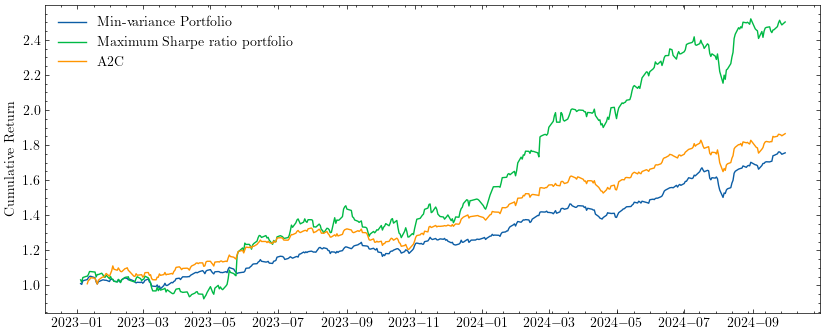

In [27]:
%matplotlib inline
with plt.style.context('science','ieee'):
    plt.figure(figsize=(10,4))
    plt.plot(markowitz_history_df.date,( 1 +markowitz_history_df.total_assets.pct_change()).cumprod(),label = 'Min-variance Portfolio')
    plt.plot(shrop_mvo.date,(shrop_mvo.total_assets.pct_change() + 1 ).cumprod(),label = 'Maximum Sharpe ratio portfolio')
    plt.plot(results_a2c['test'][0].get('date'),(results_a2c['test'][0]['account'].pct_change() + 1).cumprod(),label='A2C')
    plt.ylabel('Cumulative Return')
    plt.legend()
    plt.show()


## Buy and Hold

In [56]:
stock_dimension = len(test_data.tic.unique())

environment_train_buy_and_hold = PortfolioOptimizationEnv(
    test_data,
    initial_amount=1000000,
    comission_fee_pct=0.001,
    time_window=5,
    features = ["close", "high", "low"],
    normalize_df=None
)
terminated = False

environment_train_buy_and_hold.reset()

while not terminated:
    action = [0] + [1/stock_dimension] * stock_dimension
    _, _, terminated, _ = environment_train_buy_and_hold.step(
        np.array(action, dtype=np.float32))

Initial portfolio value:1000000
Final portfolio value: 1374643.25
Final accumulative portfolio value: 1.37464325
Maximum DrawDown: -0.20268779066109932
Sharpe ratio: 1.0171837162588477


-0.2026877854648511


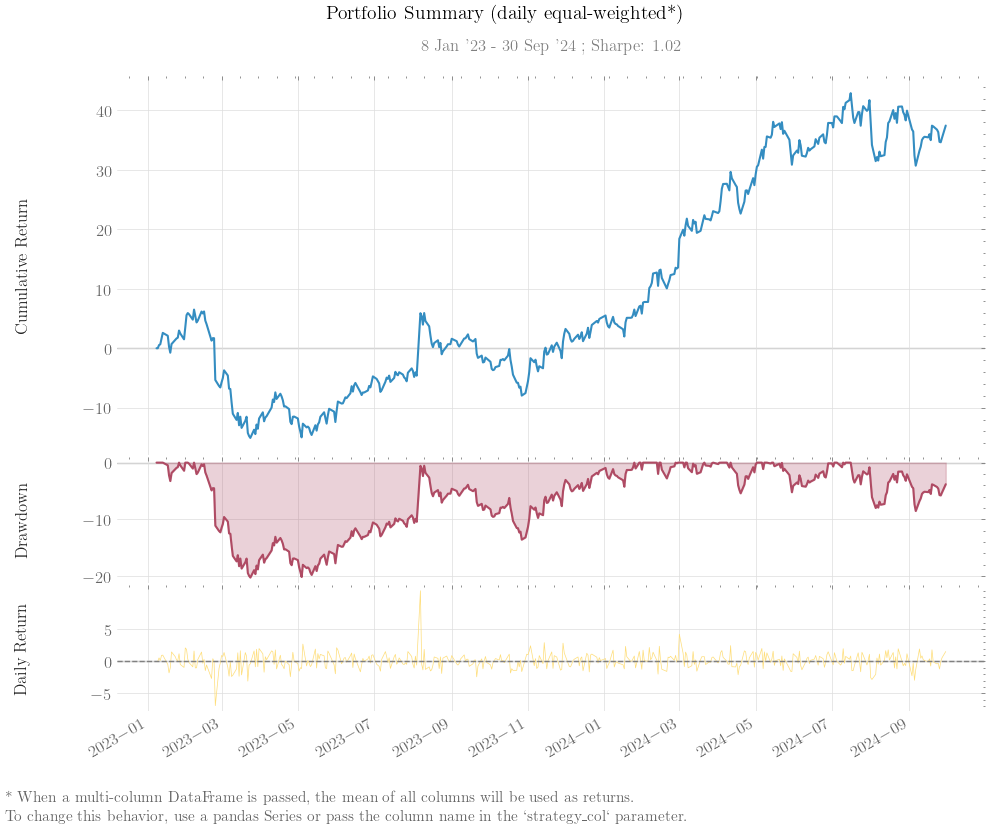

-0.2026877854648511


<Axes: >

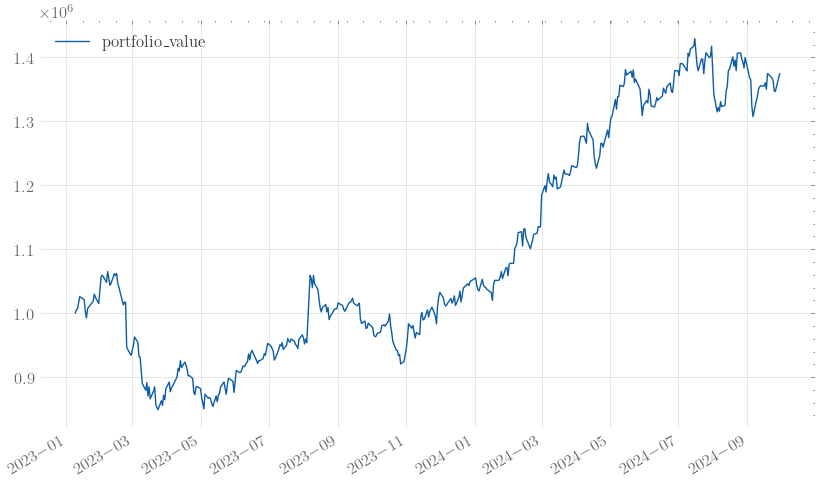

In [57]:
buy_and_hold_train = environment_train_buy_and_hold._asset_memory["final"]
buy_and_hold_weights_train = environment_train_buy_and_hold._final_weights
buy_and_hold_weights_df = pd.DataFrame(buy_and_hold_weights_train)

buy_and_hold_account_df = pd.DataFrame(buy_and_hold_train,environment_train_buy_and_hold._date_memory)

buy_and_hold_weights_df.drop(buy_and_hold_weights_df.columns[0],axis=1,inplace=True)
buy_and_hold_weights_df.columns = test_data.tic.unique()
buy_and_hold_account_df['returns'] = environment_train_buy_and_hold._portfolio_return_memory
buy_and_hold_account_df.columns = ['portfolio_value','returns']
buy_and_hold_account_df.head()
print(qs.stats.max_drawdown(buy_and_hold_account_df['returns']))
qs.plots.snapshot(buy_and_hold_account_df)
print(qs.stats.max_drawdown(buy_and_hold_account_df['returns']))
%matplotlib inline
buy_and_hold_account_df.plot(figsize=(10,6),y ='portfolio_value')

## Comparison

In [ ]:
result_dax = {
    'PPO': results_ppo,
    'A2C': results_a2c,
    'BH': environment_train_buy_and_hold,
    'MinVar': markowitz_history_df ,
    'MaxSharp': shrop_mvo,
}
with open('./data/sp500.pkl','wb') as f:
    pickle.dump(result_dax,f)

In [16]:
result_dax.keys()

dict_keys([])

Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\selector_events.py", line 115, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 10054] An existing connection was forcibly closed by the remote host
Exception in callback BaseSelectorEventLoop._read_from_self()
handle: <Handle BaseSelectorEventLoop._read_from_self()>
Traceback (most recent call last):
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\events.py", line 80, in _run
    self._context.run(self._callback, *self._args)
  File "c:\Users\versu\anaconda3\envs\Thesis\lib\asyncio\selector_events.py", line 115, in _read_from_self
    data = self._ssock.recv(4096)
ConnectionResetError: [WinError 100

In [15]:
results_a2c = result_dax['A2C']
results_ppo = result_dax['PPO']
markowitz_history_df = result_dax['MinVar']
shrop_mvo = result_dax['MaxSharp']
environment_train_buy_and_hold = result_dax['BH']

KeyError: 'A2C'

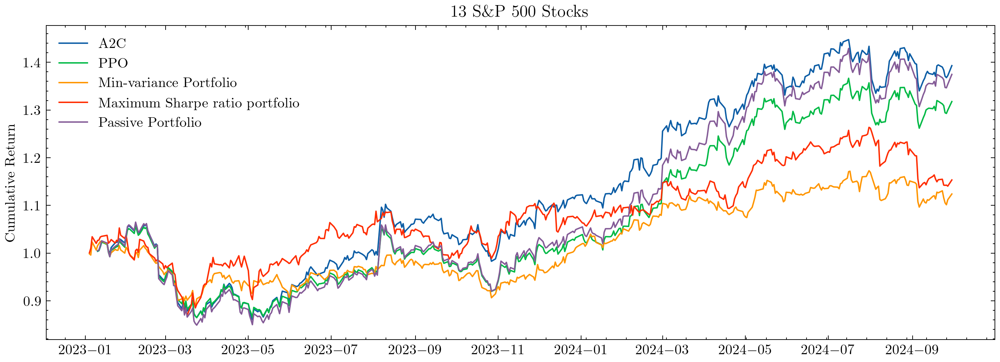

In [ ]:
with plt.style.context('science','ieee'):
    plt.figure(figsize=(12,4),dpi=300)
    plt.plot(results_a2c['test'][0].get('date'),( 1 +results_a2c['test'][0]['account'].pct_change()).cumprod(),label='A2C')
    plt.plot(results_ppo['test'][0].get('date'),(results_ppo['test'][0]['account'].pct_change() + 1).cumprod(),label='PPO')
    plt.plot(markowitz_history_df.date,( 1 +markowitz_history_df.total_assets.pct_change()).cumprod(),label = 'Minimum Variance Portfolio')
    plt.plot(shrop_mvo.date,(shrop_mvo.total_assets.pct_change() + 1 ).cumprod(),label = 'Maximum Sharpe Portfolio')
    plt.plot(environment_train_buy_and_hold._date_memory,(pd.Series(environment_train_buy_and_hold._asset_memory["final"]).pct_change() +1).cumprod(),label = 'Passive Portfolio')
    plt.ylabel('Cumulative Return')
    plt.legend()
    plt.title('13 S\&P 500 Stocks')


In [68]:
metric_dow = pd.DataFrame({
    "method" : ['Min-variane', 'Max Sharpe','A2C','PPO','Passive Portfolio'],
    "returns": [markowitz_history_df.total_assets[len(markowitz_history_df.total_assets)-1] / markowitz_history_df.total_assets[0],
                shrop_mvo.total_assets[len(shrop_mvo.total_assets)-1] / shrop_mvo.total_assets[0],
                results_a2c['test'][0]['account'][len(results_a2c['test'][0]['account'])-1] / results_a2c['test'][0]['account'][0],
                results_ppo['test'][0]['account'][len(results_ppo['test'][0]['account'])-1] / results_ppo['test'][0]['account'][0],
                environment_train_buy_and_hold._asset_memory["final"][len(environment_train_buy_and_hold._asset_memory["final"])-1] / environment_train_buy_and_hold._asset_memory["final"][0],
                ],
    "Sharp ratio": [ qs.stats.sharpe(markowitz_history_df.total_assets)
                    ,qs.stats.sharpe(shrop_mvo.total_assets)
                    ,qs.stats.sharpe(results_a2c['test'][0]['account'])
                    ,qs.stats.sharpe(results_ppo['test'][0]['account'])
                    ,qs.stats.sharpe(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))],
    "Maximum Drowdown": [ 
                     (qs.stats.max_drawdown(markowitz_history_df.total_assets)*100).round(2)
                    ,(qs.stats.max_drawdown(shrop_mvo.total_assets) *100).round(2)
                    ,(qs.stats.max_drawdown(results_a2c['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(results_ppo['test'][0]['account'])*100).round(2)
                    ,(qs.stats.max_drawdown(pd.Series(environment_train_buy_and_hold._asset_memory["final"]))*100).round(2)
                    ]
})
metric_dow

,method,returns,Sharp ratio,Maximum Drowdown
0,Min-variane,1.123997,0.578935,-13.13
1,Max Sharpe,1.153456,0.567406,-17.30
2,A2C,1.393061,1.126323,-19.06
3,PPO,1.317765,0.973370,-18.15
4,Passive Portfolio,1.374643,1.017182,-20.27


In [69]:
result_sp500 = {
    'PPO': results_ppo,
    'A2C': results_a2c,
    'BH': environment_train_buy_and_hold,
    'MinVar': markowitz_history_df ,
    'MaxSharp': shrop_mvo,
}
with open('./data/sp500.pkl','wb') as f:
    pickle.dump(result_sp500,f)

In [70]:
!pip install pandas python-pptx


   ---------------------------------------- 0.0/472.8 kB ? eta -:--:--
    --------------------------------------- 10.2/472.8 kB ? eta -:--:--
   ----- --------------------------------- 61.4/472.8 kB 825.8 kB/s eta 0:00:01
   ------------ --------------------------- 153.6/472.8 kB 1.5 MB/s eta 0:00:01
   ------------------------- -------------- 307.2/472.8 kB 1.9 MB/s eta 0:00:01
   ---------------------------------------- 472.8/472.8 kB 2.5 MB/s eta 0:00:00
   ---------------------------------------- 0.0/159.9 kB ? eta -:--:--
   ---------------------------------------- 159.9/159.9 kB 4.8 MB/s eta 0:00:00


In [99]:
import pandas as pd
from pptx import Presentation
from pptx.util import Inches



# Create a PowerPoint presentation
prs = Presentation()

# Add a slide to the presentation
slide_layout = prs.slide_layouts[5]  # Use a blank slide
slide = prs.slides.add_slide(slide_layout)

# Set table dimensions and position
rows, cols = metric_dow.shape
left = Inches(0.5)
top = Inches(1.5)
width = Inches(9)
height = Inches(0.8 + 0.5 * rows)

# Add table to the slide
table = slide.shapes.add_table(rows+1, cols, left, top, width, height).table

# Set column headers
for col_num, col_name in enumerate(metric_dow.columns):
    table.cell(0, col_num).text = col_name

# Add DataFrame rows to the table
for row_num, row in metric_dow.iterrows():
    for col_num, value in enumerate(row):
        table.cell(row_num + 1, col_num).text = str(value)

# Save the PowerPoint presentation
prs.save("./data/dataframe_to_ppt.pptx")

print("PowerPoint file saved successfully.")


PowerPoint file saved successfully.


In [ ]:
sp500 = YahooDownloader(start_date = TRAIN_START_DATE,
                     end_date = TEST_END_DATE,
                     ticker_list = np.random.choice(SP_500_TICKER,15,replace=True)).fetch_data()